In [71]:
import numpy as np
import pandas as pd
import os
from tqdm import tqdm
from collections import Counter
from sklearn.metrics import confusion_matrix

In [8]:
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

In [9]:
class uhaf_organ_trace:

    def __init__(self,uhaf_file_path):
        self.uhaf = pd.read_csv(uhaf_file_path,index_col=0)
        self.uhaf['child'] = self.uhaf.index
        self.nodes = self.uhaf['child'].unique().tolist()

    def track_cell_from_uHAF(self, cell_type_target):
        trace = []
        while cell_type_target != 'Cell':
            tar_father = self.uhaf.loc[cell_type_target].father
            trace.append(cell_type_target)
            cell_type_target = tar_father
        trace.append('Cell')
        return trace[::-1]

    def get_MCT(self, cell_type_target,layer = 1):
        # print(f'layer is {layer}')
        trace = self.track_cell_from_uHAF(cell_type_target)
        assert len(trace) > layer
        return trace[layer]

def is_ancester(fine_ct,MCT,uhaf_trace):
    if MCT in uhaf_trace.track_cell_from_uHAF(fine_ct):
        return True
    else:
        return False



In [10]:
def plot_confusion_matrix(confm, true_labels, all_labels, title, size=20, with_text=True, saving = None):
    """
    Plot a confusion matrix.

    Parameters:
    - confm: Original confusion matrix
    - true_labels: List of true labels
    - all_labels: List of all labels in the order they appear in confm
    - title: Title of the plot
    - size: Size of the plot
    - with_text: Whether to include text in the cells
    """
    plt.figure(figsize=(size, size))

    # Extract relevant rows based on true labels
    confm_selected = cm[[labels.index(lab) for lab in true_labels]]

    # Normalize
    confm_selected = confm_selected.astype('float') / (confm_selected.sum(axis=1)[:, np.newaxis] + 1e-9)
    confm_selected = np.around(confm_selected, 4)

    ax = plt.subplot(1, 1, 1)
    plt.imshow(confm_selected, interpolation='nearest', cmap='Blues')

    if with_text:
        for i in range(len(confm_selected)):
            for j in range(len(confm_selected[0])):
                color = 'w' if confm_selected[i, j] > 0.5 else 'black'
                plt.text(j, i, confm_selected[i, j], ha="center", va="center", color=color)

    plt.title(title)
    plt.xticks(np.arange(len(all_labels)), all_labels, rotation=90)
    plt.yticks(np.arange(len(true_labels)), true_labels, rotation=0)
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.tick_params(bottom=False, top=False, left=False, right=False)
    ax.spines['left'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    if not (saving is None):
        plt.savefig(saving)
    plt.show()

In [11]:
plt.rcParams.update({'font.size': 14})
plt.rcParams['font.family'] = 'Arial'
plt.rcParams['pdf.fonttype'] = 42

# Heart

In [72]:
uhaf_trace = uhaf_organ_trace(os.path.join("./", 'uHAF/Heart_pair_ver.csv'))

### celltypist trained on Multiorgan

In [80]:
df_result = pd.read_csv("Celltypist_Anno_Result/Heart/Simonson.csv",index_col = 0)
df_result.labels[df_result.labels=="Lyphatic endothelial cell"] = "Lymphatic endothelial cell"
preds_ = list(df_result.predictions[df_result.labels!="Unclassified"])
targets_ = list(df_result.labels[df_result.labels!="Unclassified"])

In [81]:
target_cell_types = set(targets_)
pred_correct = []
for pred, target in zip(tqdm(preds_), targets_):
    if pred in uhaf_trace.uhaf.index.tolist() and is_ancester(pred,target, uhaf_trace):
        pred_correct.append(target)
    #elif not pred in target_cell_types:
    #    pred_correct.append("Others")
    else:
        pred_correct.append(pred)

100%|██████████| 58777/58777 [00:04<00:00, 14379.89it/s]


In [82]:
pred_correct2 = pd.Series(pred_correct)
pred_correct2[- pred_correct2.isin(np.unique(targets_))] = "Others"
pred_correct2 = list(pred_correct2)

In [83]:
accuracy = accuracy_score(targets_, pred_correct2)
precision = precision_score(targets_, pred_correct2, average="weighted")
precision_macro = precision_score(targets_, pred_correct2, average="macro")
recall = recall_score(targets_, pred_correct2, average="weighted")
weighted_f1 = f1_score(targets_, pred_correct2, average="weighted")
macro_f1 = f1_score(targets_, pred_correct2, average="macro")

results = {
        "test/accuracy": accuracy,
        "test/precision": precision,
        "test/precision_macro": precision_macro,
        "test/recall": recall,
        "test/weighted_f1": weighted_f1,
        "test/macro_f1": macro_f1,
    }
print(results)

/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


{'test/accuracy': 0.8646749578916924, 'test/precision': 0.9417109292697282, 'test/precision_macro': 0.6957944829757136, 'test/recall': 0.8646749578916924, 'test/weighted_f1': 0.8946156872358038, 'test/macro_f1': 0.5976905521699546}


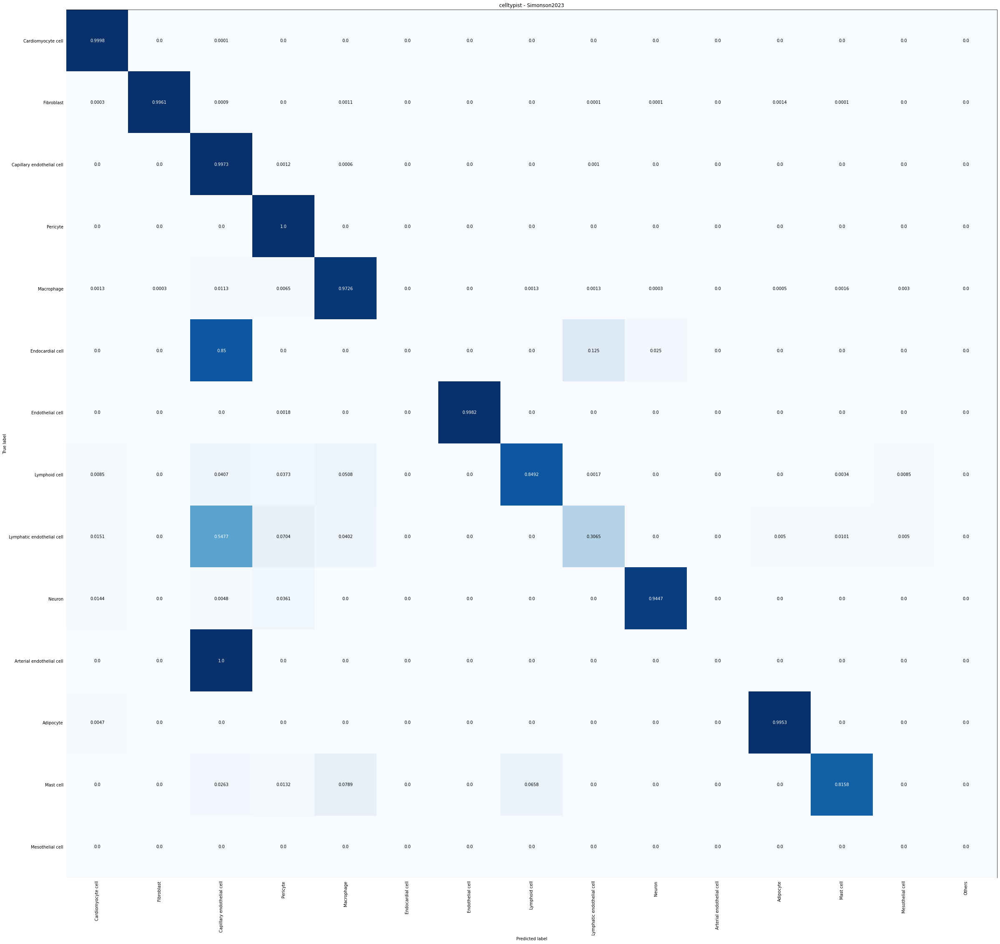

In [84]:
total_labels = list(Counter(targets_ + pred_correct2).keys())

sorted_keys = sorted(Counter(targets_).keys(), key=lambda x: Counter(targets_)[x], reverse=True)
true_labels = sorted_keys.copy()

labels = sorted_keys
labels.extend(set(total_labels) - set(true_labels))

cm = confusion_matrix(targets_, pred_correct, labels=labels)
plot_confusion_matrix(cm, true_labels, labels, "celltypist - Simonson2023",size =40, saving="anno_figures/Heart_celltypist_CM.pdf")

### scGPT finetune on Multiorgan

In [18]:
df_result = pd.read_csv("Multi_result/Heart_results/Simonson 2023/prediction_result.csv",index_col = 0)
df_result.labels[df_result.labels=="Lyphatic endothelial cell"] = "Lymphatic endothelial cell"
preds_ = list(df_result.predictions[df_result.labels!="Unclassified"])
targets_ = list(df_result.labels[df_result.labels!="Unclassified"])

In [19]:
target_cell_types = set(targets_)
pred_correct = []
for pred, target in zip(tqdm(preds_), targets_):
    if pred in uhaf_trace.uhaf.index.tolist() and is_ancester(pred,target, uhaf_trace):
        pred_correct.append(target)
    #elif not pred in target_cell_types:
    #    pred_correct.append("Others")
    else:
        pred_correct.append(pred)

100%|██████████| 58777/58777 [00:05<00:00, 10991.78it/s]


In [20]:
pred_correct2 = pd.Series(pred_correct)
pred_correct2[- pred_correct2.isin(np.unique(targets_))] = "Others"
pred_correct2 = list(pred_correct2)

In [21]:
accuracy = accuracy_score(targets_, pred_correct2)
precision = precision_score(targets_, pred_correct2, average="weighted")
precision_macro = precision_score(targets_, pred_correct2, average="macro")
recall = recall_score(targets_, pred_correct2, average="weighted")
weighted_f1 = f1_score(targets_, pred_correct2, average="weighted")
macro_f1 = f1_score(targets_, pred_correct2, average="macro")

results = {
        "test/accuracy": accuracy,
        "test/precision": precision,
        "test/precision_macro": precision_macro,
        "test/recall": recall,
        "test/weighted_f1": weighted_f1,
        "test/macro_f1": macro_f1,
    }
print(results)

/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


{'test/accuracy': 0.8768736070231553, 'test/precision': 0.9375424252946082, 'test/precision_macro': 0.6756352290260389, 'test/recall': 0.8768736070231553, 'test/weighted_f1': 0.89826842663134, 'test/macro_f1': 0.5769028756341429}


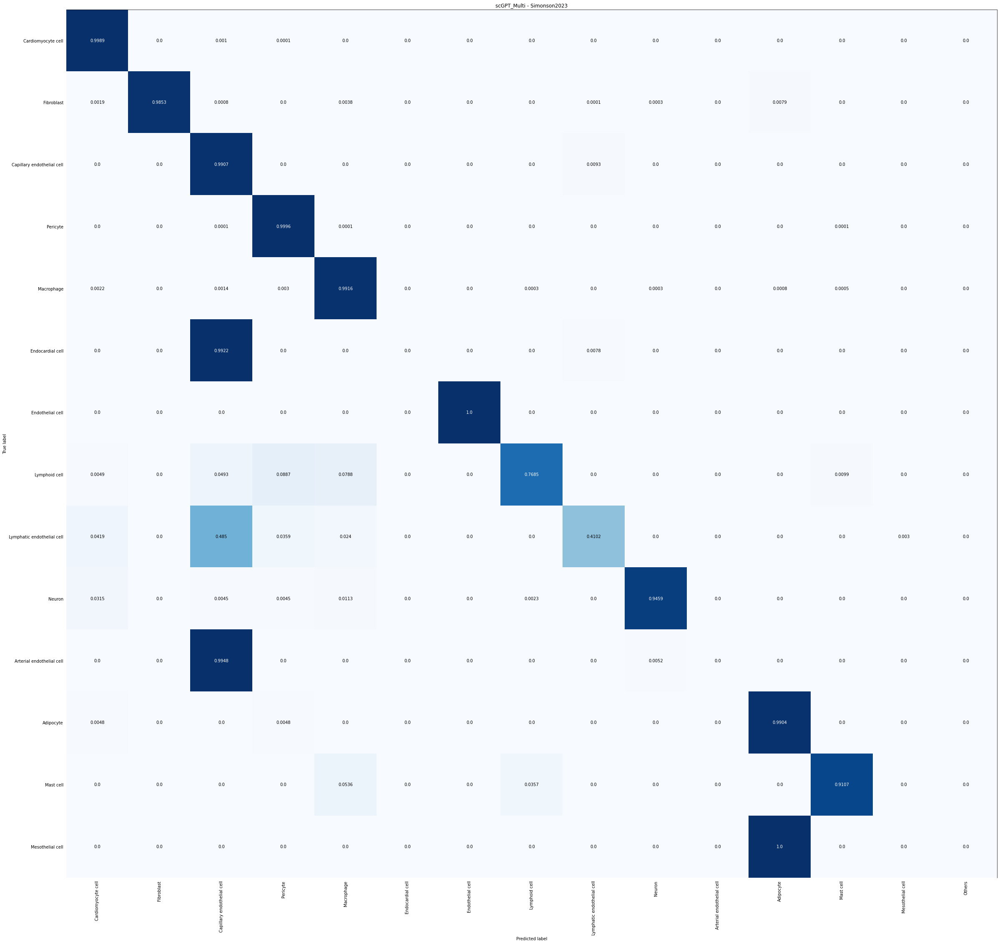

In [22]:
total_labels = list(Counter(targets_ + pred_correct2).keys())

sorted_keys = sorted(Counter(targets_).keys(), key=lambda x: Counter(targets_)[x], reverse=True)
true_labels = sorted_keys.copy()

labels = sorted_keys
labels.extend(set(total_labels) - set(true_labels))

cm = confusion_matrix(targets_, pred_correct, labels=labels)
plot_confusion_matrix(cm, true_labels, labels, "scGPT_Multi - Simonson2023",size =40, saving="anno_figures/Heart_scGPT_CM.pdf")

### Geneformer

In [73]:
df_result = pd.read_csv("/home/chenyx/GeneFormer_Test/GeneFormer_Anno_Heart_Simonson2023.csv",index_col = 0)
df_result.labels[df_result.labels=="Lyphatic endothelial cell"] = "Lymphatic endothelial cell"
preds_ = list(df_result.predictions[df_result.labels!="Unclassified"])
targets_ = list(df_result.labels[df_result.labels!="Unclassified"])

In [74]:
target_cell_types = set(targets_)
pred_correct = []
for pred, target in zip(tqdm(preds_), targets_):
    if pred in uhaf_trace.uhaf.index.tolist() and is_ancester(pred,target, uhaf_trace):
        pred_correct.append(target)
    #elif not pred in target_cell_types:
    #    pred_correct.append("Others")
    else:
        pred_correct.append(pred)

100%|██████████| 58777/58777 [00:03<00:00, 18401.27it/s]


In [75]:
pred_correct2 = pd.Series(pred_correct)
pred_correct2[- pred_correct2.isin(np.unique(targets_))] = "Others"
pred_correct2 = list(pred_correct2)

In [76]:
accuracy = accuracy_score(targets_, pred_correct2)
precision = precision_score(targets_, pred_correct2, average="weighted")
precision_macro = precision_score(targets_, pred_correct2, average="macro")
recall = recall_score(targets_, pred_correct2, average="weighted")
weighted_f1 = f1_score(targets_, pred_correct2, average="weighted")
macro_f1 = f1_score(targets_, pred_correct2, average="macro")

results = {
        "test/accuracy": accuracy,
        "test/precision": precision,
        "test/precision_macro": precision_macro,
        "test/recall": recall,
        "test/weighted_f1": weighted_f1,
        "test/macro_f1": macro_f1,
    }
print(results)

/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


{'test/accuracy': 0.5884614730251629, 'test/precision': 0.9391439560144138, 'test/precision_macro': 0.6182148840902207, 'test/recall': 0.5884614730251629, 'test/weighted_f1': 0.6350453195269978, 'test/macro_f1': 0.3377540610197857}


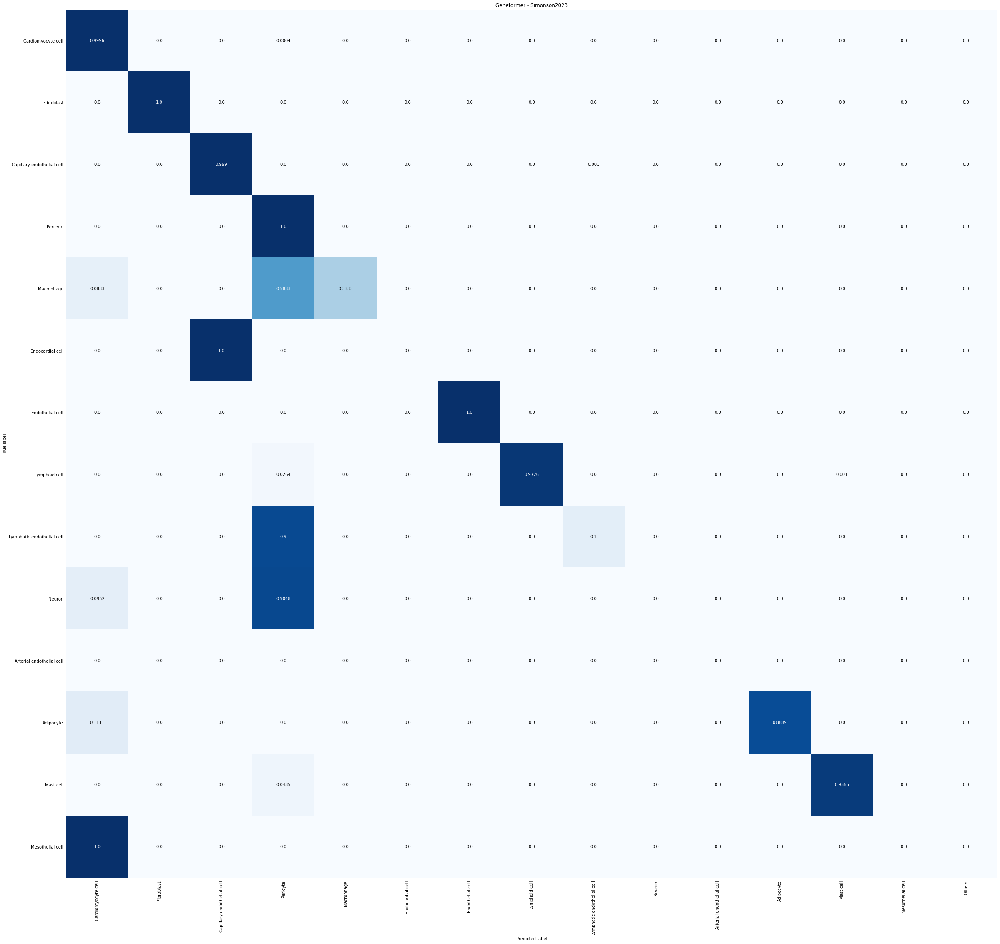

In [79]:
total_labels = list(Counter(targets_ + pred_correct2).keys())

sorted_keys = sorted(Counter(targets_).keys(), key=lambda x: Counter(targets_)[x], reverse=True)
true_labels = sorted_keys.copy()

labels = sorted_keys
labels.extend(set(total_labels) - set(true_labels))

cm = confusion_matrix(targets_, pred_correct, labels=labels)
plot_confusion_matrix(cm, true_labels, labels, "Geneformer - Simonson2023",size =40, saving="anno_figures/Heart_Geneformer_CM.pdf")

### scMuLan

In [60]:
df_result = pd.read_csv("/nfs/public/cell_gpt_data/Test_data/Heart/simons.csv",index_col = 0)
df_result.cell_type[df_result.cell_type=="Lyphatic endothelial cell"] = "Lymphatic endothelial cell"
preds_ = list(df_result.preds_ori[df_result.cell_type!="Unclassified"])
targets_ = list(df_result.cell_type[df_result.cell_type!="Unclassified"])

/tmp/ipykernel_28905/2233671284.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_result.cell_type[df_result.cell_type=="Lyphatic endothelial cell"] = "Lymphatic endothelial cell"


In [61]:
target_cell_types = set(targets_)
pred_correct = []
for pred, target in zip(tqdm(preds_), targets_):
    if pred in uhaf_trace.uhaf.index.tolist() and is_ancester(pred,target, uhaf_trace):
        pred_correct.append(target)
    #elif not pred in target_cell_types:
    #    pred_correct.append("Others")
    else:
        pred_correct.append(pred)

100%|██████████| 58777/58777 [00:03<00:00, 14990.83it/s]


In [62]:
pred_correct2 = pd.Series(pred_correct)
pred_correct2[- pred_correct2.isin(np.unique(targets_))] = "Others"
pred_correct2 = list(pred_correct2)

In [63]:
accuracy = accuracy_score(targets_, pred_correct2)
precision = precision_score(targets_, pred_correct2, average="weighted")
precision_macro = precision_score(targets_, pred_correct2, average="macro")
recall = recall_score(targets_, pred_correct2, average="weighted")
weighted_f1 = f1_score(targets_, pred_correct2, average="weighted")
macro_f1 = f1_score(targets_, pred_correct2, average="macro")

results = {
        "test/accuracy": accuracy,
        "test/precision": precision,
        "test/precision_macro": precision_macro,
        "test/recall": recall,
        "test/weighted_f1": weighted_f1,
        "test/macro_f1": macro_f1,
    }
print(results)

/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


{'test/accuracy': 0.9249536383279174, 'test/precision': 0.9470914433379128, 'test/precision_macro': 0.7157922630895684, 'test/recall': 0.9249536383279174, 'test/weighted_f1': 0.9330585392881865, 'test/macro_f1': 0.6367538924721996}


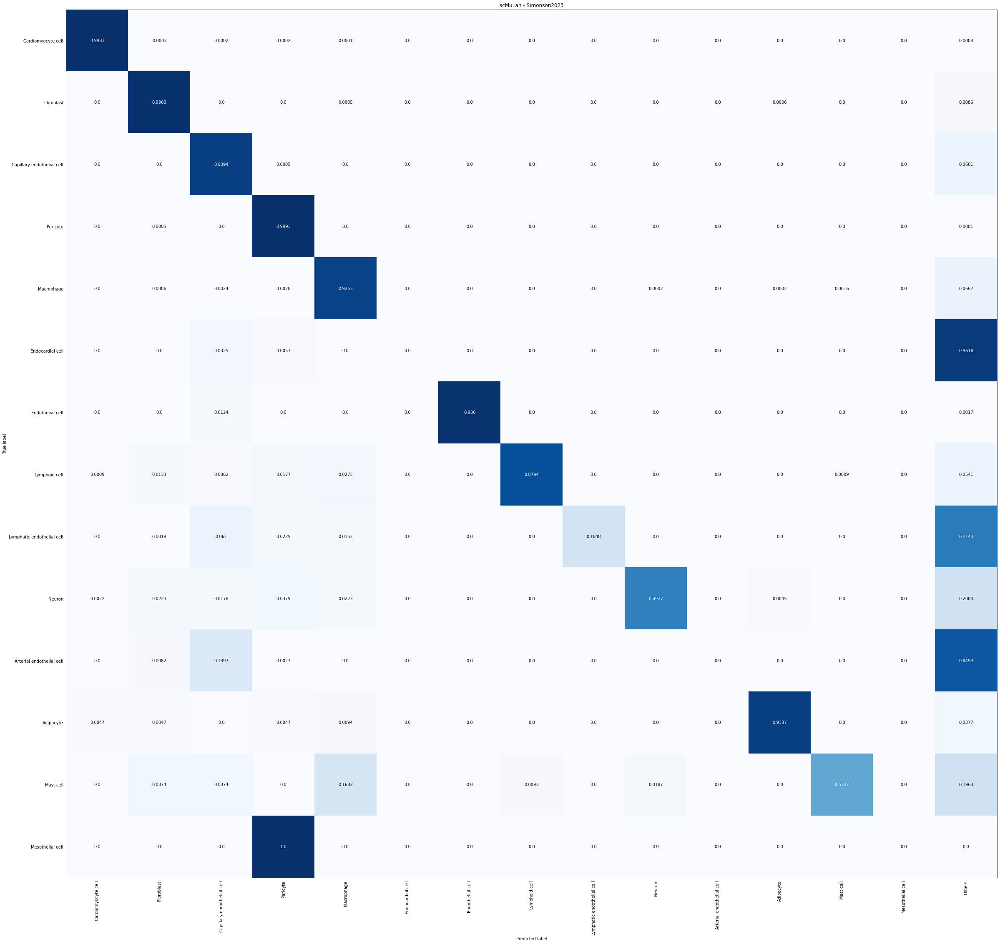

In [64]:
total_labels = list(Counter(targets_ + pred_correct2).keys())

sorted_keys = sorted(Counter(targets_).keys(), key=lambda x: Counter(targets_)[x], reverse=True)
true_labels = sorted_keys.copy()

labels = sorted_keys
labels.extend(set(total_labels) - set(true_labels))

cm = confusion_matrix(targets_, pred_correct2, labels=labels)
plot_confusion_matrix(cm, true_labels, labels, "scMuLan - Simonson2023",size =40, saving="anno_figures/Heart_scMulan_CM.pdf")

# Liver

In [92]:
uhaf_trace = uhaf_organ_trace(os.path.join("./", 'uHAF/Liver_pair_ver.csv'))

### celltypist trained on Multiorgan

In [29]:
df_result = pd.read_csv("Celltypist_Anno_Result/Liver/Testset1.csv",index_col = 0)
df_result.labels[df_result.labels=="Neutrophilic granulocyte"] = "Granulocyte"
preds_ = list(df_result.predictions)
targets_ = list(df_result.labels)

In [30]:
target_cell_types = set(targets_)
pred_correct = []
for pred, target in zip(tqdm(preds_), targets_):
    if pred in uhaf_trace.uhaf.index.tolist() and is_ancester(pred,target, uhaf_trace):
        pred_correct.append(target)
    #elif not pred in target_cell_types:
    #    pred_correct.append("Others")
    else:
        pred_correct.append(pred)

100%|██████████| 137181/137181 [00:09<00:00, 14592.66it/s]


In [31]:
pred_correct2 = pd.Series(pred_correct)
pred_correct2[- pred_correct2.isin(np.unique(targets_))] = "Others"
pred_correct2 = list(pred_correct2)

In [32]:
accuracy = accuracy_score(targets_, pred_correct2)
precision = precision_score(targets_, pred_correct2, average="weighted")
precision_macro = precision_score(targets_, pred_correct2, average="macro")
recall = recall_score(targets_, pred_correct2, average="weighted")
weighted_f1 = f1_score(targets_, pred_correct2, average="weighted")
macro_f1 = f1_score(targets_, pred_correct2, average="macro")

results = {
        "test/accuracy": accuracy,
        "test/precision": precision,
        "test/precision_macro": precision_macro,
        "test/recall": recall,
        "test/weighted_f1": weighted_f1,
        "test/macro_f1": macro_f1,
    }
print(results)

/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


{'test/accuracy': 0.6904600491321684, 'test/precision': 0.9077194076517777, 'test/precision_macro': 0.6952942170975782, 'test/recall': 0.6904600491321684, 'test/weighted_f1': 0.724901205415878, 'test/macro_f1': 0.40277612065383595}


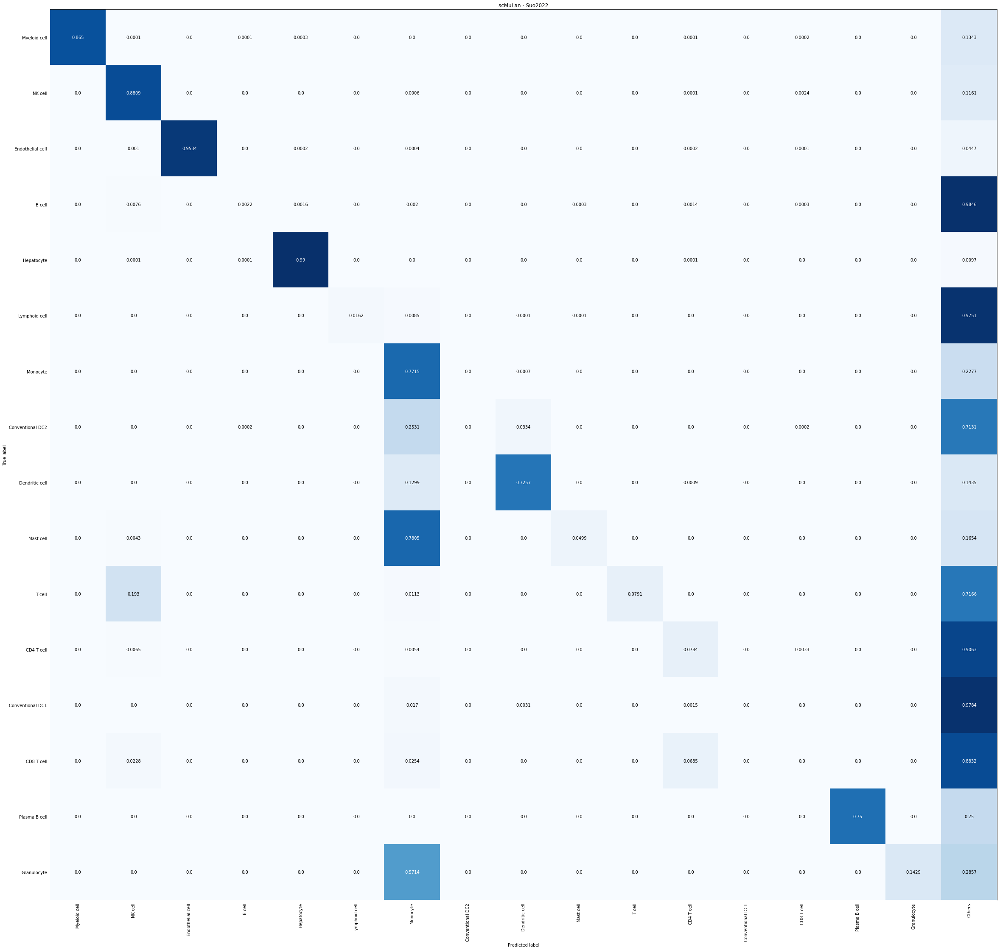

In [33]:
total_labels = list(Counter(targets_ + pred_correct2).keys())

sorted_keys = sorted(Counter(targets_).keys(), key=lambda x: Counter(targets_)[x], reverse=True)
true_labels = sorted_keys.copy()

labels = sorted_keys
labels.extend(set(total_labels) - set(true_labels))

cm = confusion_matrix(targets_, pred_correct2, labels=labels)
plot_confusion_matrix(cm, true_labels, labels, "scMuLan - Suo2022",size =40, saving="anno_figures/Liver_celltypist_CM.pdf")

### scGPT finetune on Multiorgan

In [34]:
df_result = pd.read_csv("Multi_result/Liver_results/Testset1/prediction_result.csv",index_col = 0)
df_result.labels[df_result.labels=="Neutrophilic granulocyte"] = "Granulocyte"
preds_ = list(df_result.predictions)
targets_ = list(df_result.labels)

In [35]:
target_cell_types = set(targets_)
pred_correct = []
for pred, target in zip(tqdm(preds_), targets_):
    if pred in uhaf_trace.uhaf.index.tolist() and is_ancester(pred,target, uhaf_trace):
        pred_correct.append(target)
    #elif not pred in target_cell_types:
    #    pred_correct.append("Others")
    else:
        pred_correct.append(pred)

100%|██████████| 137181/137181 [00:11<00:00, 12300.93it/s]


In [36]:
pred_correct2 = pd.Series(pred_correct)
pred_correct2[- pred_correct2.isin(np.unique(targets_))] = "Others"
pred_correct2 = list(pred_correct2)

In [37]:
accuracy = accuracy_score(targets_, pred_correct2)
precision = precision_score(targets_, pred_correct2, average="weighted")
precision_macro = precision_score(targets_, pred_correct2, average="macro")
recall = recall_score(targets_, pred_correct2, average="weighted")
weighted_f1 = f1_score(targets_, pred_correct2, average="weighted")
macro_f1 = f1_score(targets_, pred_correct2, average="macro")

results = {
        "test/accuracy": accuracy,
        "test/precision": precision,
        "test/precision_macro": precision_macro,
        "test/recall": recall,
        "test/weighted_f1": weighted_f1,
        "test/macro_f1": macro_f1,
    }
print(results)

/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


{'test/accuracy': 0.6860498173945372, 'test/precision': 0.9284047713863633, 'test/precision_macro': 0.6796877606902221, 'test/recall': 0.6860498173945372, 'test/weighted_f1': 0.7401702075134019, 'test/macro_f1': 0.4734889092334887}


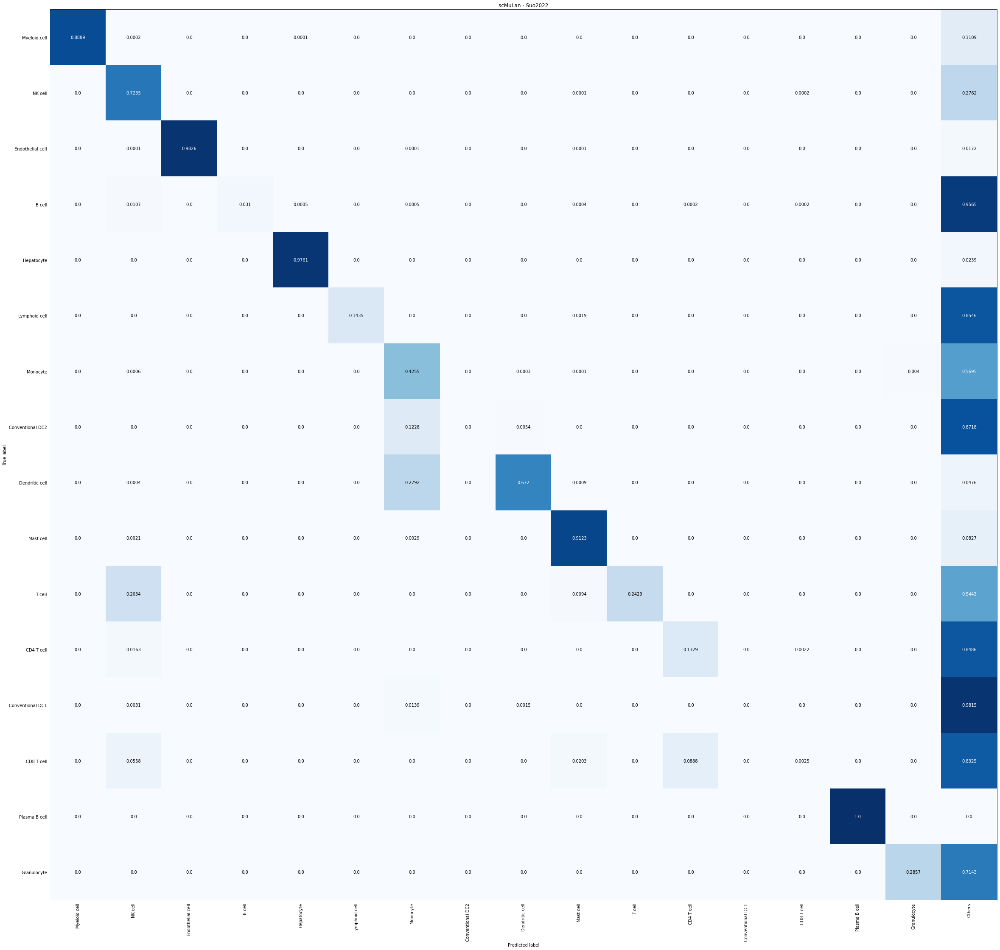

In [38]:
total_labels = list(Counter(targets_ + pred_correct2).keys())

sorted_keys = sorted(Counter(targets_).keys(), key=lambda x: Counter(targets_)[x], reverse=True)
true_labels = sorted_keys.copy()

labels = sorted_keys
labels.extend(set(total_labels) - set(true_labels))

cm = confusion_matrix(targets_, pred_correct2, labels=labels)
plot_confusion_matrix(cm, true_labels, labels, "scMuLan - Suo2022",size =40, saving="anno_figures/Liver_scGPT_CM.pdf")

### Geneformer

In [93]:
df_result = pd.read_csv("/home/chenyx/GeneFormer_Test/GeneFormer_Anno_Bonemarraw_AHCA.csv",index_col = 0)
df_result.labels[df_result.labels=="Neutrophilic granulocyte"] = "Granulocyte"
preds_ = list(df_result.predictions[df_result.labels!="Unclassified"])
targets_ = list(df_result.labels[df_result.labels!="Unclassified"])

In [94]:
target_cell_types = set(targets_)
pred_correct = []
for pred, target in zip(tqdm(preds_), targets_):
    if pred in uhaf_trace.uhaf.index.tolist() and is_ancester(pred,target, uhaf_trace):
        pred_correct.append(target)
    #elif not pred in target_cell_types:
    #    pred_correct.append("Others")
    else:
        pred_correct.append(pred)

100%|██████████| 3230/3230 [00:00<00:00, 5780.81it/s]


In [95]:
pred_correct2 = pd.Series(pred_correct)
pred_correct2[- pred_correct2.isin(np.unique(targets_))] = "Others"
pred_correct2 = list(pred_correct2)

In [96]:
accuracy = accuracy_score(targets_, pred_correct2)
precision = precision_score(targets_, pred_correct2, average="weighted")
precision_macro = precision_score(targets_, pred_correct2, average="macro")
recall = recall_score(targets_, pred_correct2, average="weighted")
weighted_f1 = f1_score(targets_, pred_correct2, average="weighted")
macro_f1 = f1_score(targets_, pred_correct2, average="macro")

results = {
        "test/accuracy": accuracy,
        "test/precision": precision,
        "test/precision_macro": precision_macro,
        "test/recall": recall,
        "test/weighted_f1": weighted_f1,
        "test/macro_f1": macro_f1,
    }
print(results)

{'test/accuracy': 0.7928792569659443, 'test/precision': 0.7982432140542876, 'test/precision_macro': 0.2844961240310077, 'test/recall': 0.7928792569659443, 'test/weighted_f1': 0.7954113199616626, 'test/macro_f1': 0.2886330744446036}


/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


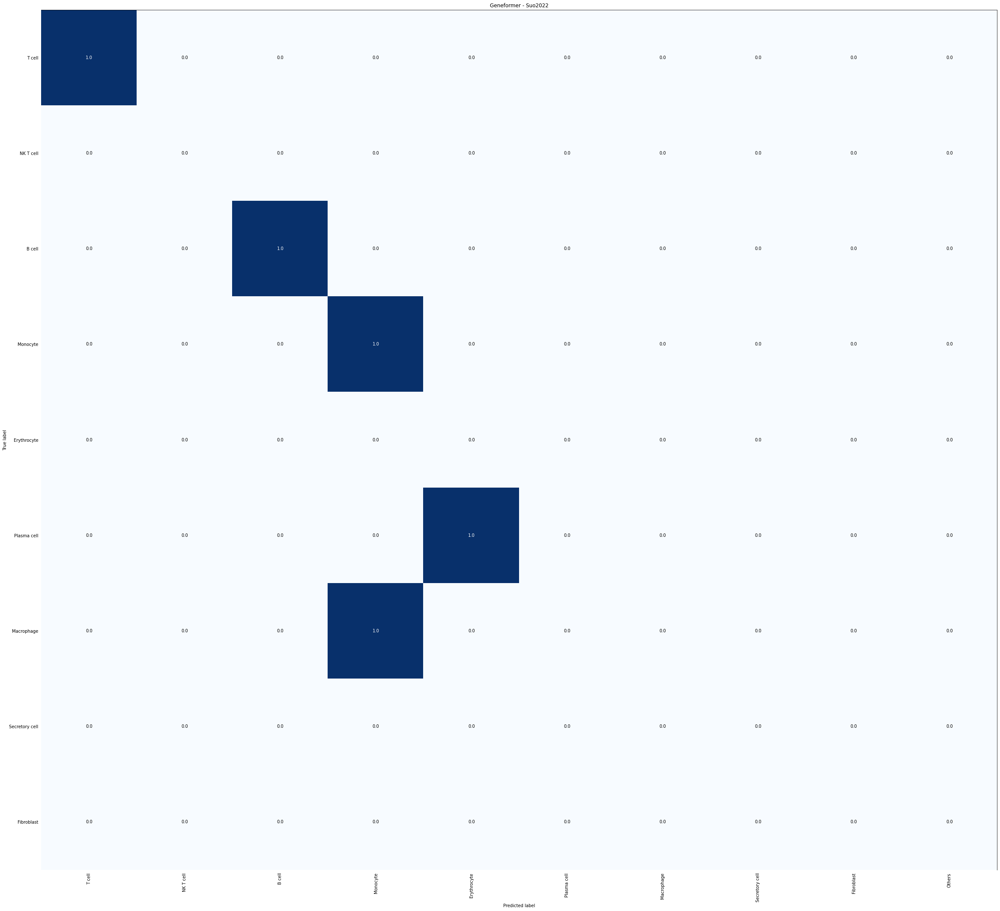

In [97]:
total_labels = list(Counter(targets_ + pred_correct2).keys())

sorted_keys = sorted(Counter(targets_).keys(), key=lambda x: Counter(targets_)[x], reverse=True)
true_labels = sorted_keys.copy()

labels = sorted_keys
labels.extend(set(total_labels) - set(true_labels))

cm = confusion_matrix(targets_, pred_correct, labels=labels)
plot_confusion_matrix(cm, true_labels, labels, "Geneformer - Suo2022",size =40, saving="anno_figures/Liver_Geneformer_CM.pdf")

### scMuLan

In [39]:
df_result = pd.read_csv("/nfs/public/cell_gpt_data/Test_data/Heart/liver_test_1.csv",index_col = 0)
df_result.cell_type[df_result.cell_type=="Neutrophilic granulocyte"] = "Granulocyte"
df_result.cell_type[df_result.cell_type=='Conventional DC1'] = 'Conventional dendritic cell 1'
df_result.cell_type[df_result.cell_type=='Conventional DC2'] = 'Conventional dendritic cell 2'

preds_ = list(df_result.preds_ori)
targets_ = list(df_result.cell_type)

/tmp/ipykernel_28905/2317532372.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_result.cell_type[df_result.cell_type=="Neutrophilic granulocyte"] = "Granulocyte"
/tmp/ipykernel_28905/2317532372.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_result.cell_type[df_result.cell_type=='Conventional DC1'] = 'Conventional dendritic cell 1'
/tmp/ipykernel_28905/2317532372.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_resu

In [40]:
target_cell_types = set(targets_)
pred_correct = []
for pred, target in zip(tqdm(preds_), targets_):
    if pred in uhaf_trace.uhaf.index.tolist() and is_ancester(pred,target, uhaf_trace):
        pred_correct.append(target)
    #elif not pred in target_cell_types:
    #    pred_correct.append("Others")
    else:
        pred_correct.append(pred)

100%|██████████| 137181/137181 [00:11<00:00, 11879.48it/s]


In [41]:
pred_correct2 = pd.Series(pred_correct)
pred_correct2[- pred_correct2.isin(np.unique(targets_))] = "Others"
pred_correct2 = list(pred_correct2)

In [42]:
accuracy = accuracy_score(targets_, pred_correct2)
precision = precision_score(targets_, pred_correct2, average="weighted")
precision_macro = precision_score(targets_, pred_correct2, average="macro")
recall = recall_score(targets_, pred_correct2, average="weighted")
weighted_f1 = f1_score(targets_, pred_correct2, average="weighted")
macro_f1 = f1_score(targets_, pred_correct2, average="macro")

results = {
        "test/accuracy": accuracy,
        "test/precision": precision,
        "test/precision_macro": precision_macro,
        "test/recall": recall,
        "test/weighted_f1": weighted_f1,
        "test/macro_f1": macro_f1,
    }
print(results)

/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


{'test/accuracy': 0.873204015133291, 'test/precision': 0.9626360046638642, 'test/precision_macro': 0.7008175834773588, 'test/recall': 0.873204015133291, 'test/weighted_f1': 0.8941275946530245, 'test/macro_f1': 0.6401056056444546}


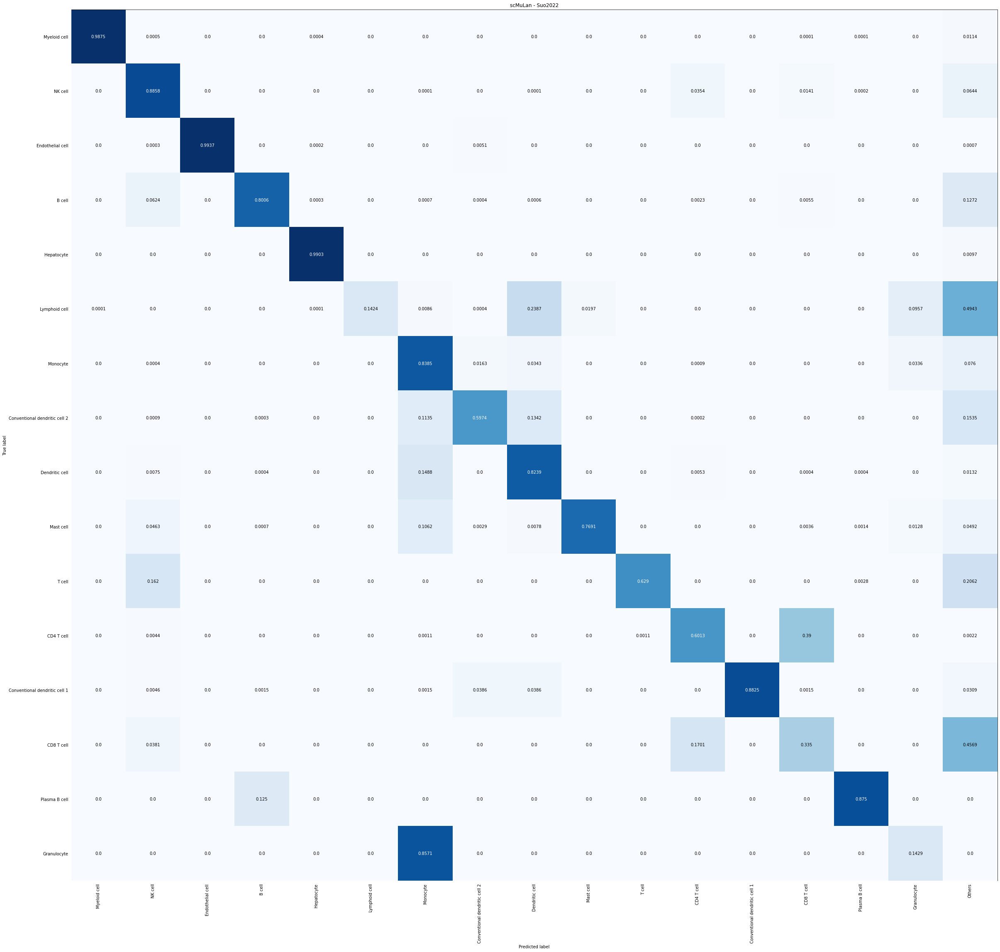

In [43]:
total_labels = list(Counter(targets_ + pred_correct2).keys())

sorted_keys = sorted(Counter(targets_).keys(), key=lambda x: Counter(targets_)[x], reverse=True)
true_labels = sorted_keys.copy()

labels = sorted_keys
labels.extend(set(total_labels) - set(true_labels))

cm = confusion_matrix(targets_, pred_correct2, labels=labels)
plot_confusion_matrix(cm, true_labels, labels, "scMuLan - Suo2022",size =40, saving="anno_figures/Liver_scMulan_CM.pdf")

# Bone Marrow

In [98]:
uhaf_trace = uhaf_organ_trace(os.path.join("./", 'uHAF/Bone marrow_pair_ver.csv'))

## celltypist trained on Multiorgan

In [45]:
df_result = pd.read_csv("Celltypist_Anno_Result/BoneMarrow/AHCA.csv",index_col = 0)

df_result.labels[df_result.labels=="NK T cell"] = "NK cell"
df_result.labels[df_result.labels=="Plasma cell"] = "Plasma B cell"
df_result.labels[df_result.labels=="Erythrocyte"] = "Erythroblast"

preds_ = list(df_result.predictions)
targets_ = list(df_result.labels)

In [46]:
target_cell_types = set(targets_)
pred_correct = []
for pred, target in zip(tqdm(preds_), targets_):
    if pred in uhaf_trace.uhaf.index.tolist() and is_ancester(pred,target, uhaf_trace):
        pred_correct.append(target)
    #elif not pred in target_cell_types:
    #    pred_correct.append("Others")
    else:
        pred_correct.append(pred)

100%|██████████| 3230/3230 [00:00<00:00, 8198.62it/s]


In [47]:
pred_correct2 = pd.Series(pred_correct)
pred_correct2[- pred_correct2.isin(np.unique(targets_))] = "Others"
pred_correct2 = list(pred_correct2)

In [48]:
accuracy = accuracy_score(targets_, pred_correct2)
precision = precision_score(targets_, pred_correct2, average="weighted")
precision_macro = precision_score(targets_, pred_correct2, average="macro")
recall = recall_score(targets_, pred_correct2, average="weighted")
weighted_f1 = f1_score(targets_, pred_correct2, average="weighted")
macro_f1 = f1_score(targets_, pred_correct2, average="macro")

results = {
        "test/accuracy": accuracy,
        "test/precision": precision,
        "test/precision_macro": precision_macro,
        "test/recall": recall,
        "test/weighted_f1": weighted_f1,
        "test/macro_f1": macro_f1,
    }
print(results)

/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


{'test/accuracy': 0.7018575851393188, 'test/precision': 0.8764469857926405, 'test/precision_macro': 0.7575874276026557, 'test/recall': 0.7018575851393188, 'test/weighted_f1': 0.766493359712257, 'test/macro_f1': 0.6659878720814829}


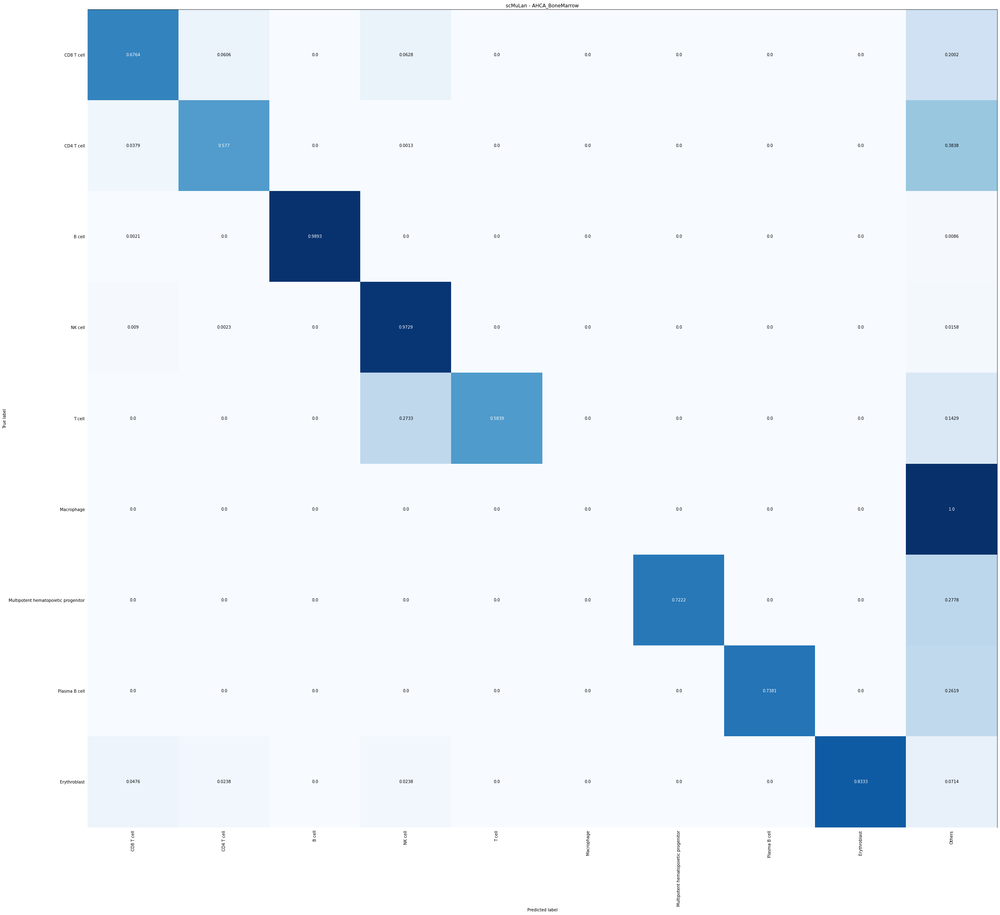

In [49]:
total_labels = list(Counter(targets_ + pred_correct2).keys())

sorted_keys = sorted(Counter(targets_).keys(), key=lambda x: Counter(targets_)[x], reverse=True)
true_labels = sorted_keys.copy()

labels = sorted_keys
labels.extend(set(total_labels) - set(true_labels))

cm = confusion_matrix(targets_, pred_correct2, labels=labels)
plot_confusion_matrix(cm, true_labels, labels, "scMuLan - AHCA_BoneMarrow",size =40, saving="anno_figures/BoneMarrow_celltypist_CM.pdf")

## Geneformer

In [99]:
df_result = pd.read_csv("/home/chenyx/GeneFormer_Test/GeneFormer_Anno_Heart_Simonson2023.csv",index_col = 0)

df_result.labels[df_result.labels=="NK T cell"] = "NK cell"
df_result.labels[df_result.labels=="Plasma cell"] = "Plasma B cell"
df_result.labels[df_result.labels=="Erythrocyte"] = "Erythroblast"

preds_ = list(df_result.predictions[df_result.labels!="Unclassified"])
targets_ = list(df_result.labels[df_result.labels!="Unclassified"])

In [100]:
target_cell_types = set(targets_)
pred_correct = []
for pred, target in zip(tqdm(preds_), targets_):
    if pred in uhaf_trace.uhaf.index.tolist() and is_ancester(pred,target, uhaf_trace):
        pred_correct.append(target)
    #elif not pred in target_cell_types:
    #    pred_correct.append("Others")
    else:
        pred_correct.append(pred)

100%|██████████| 58777/58777 [00:02<00:00, 27933.21it/s]


In [101]:
pred_correct2 = pd.Series(pred_correct)
pred_correct2[- pred_correct2.isin(np.unique(targets_))] = "Others"
pred_correct2 = list(pred_correct2)

In [102]:
accuracy = accuracy_score(targets_, pred_correct2)
precision = precision_score(targets_, pred_correct2, average="weighted")
precision_macro = precision_score(targets_, pred_correct2, average="macro")
recall = recall_score(targets_, pred_correct2, average="weighted")
weighted_f1 = f1_score(targets_, pred_correct2, average="weighted")
macro_f1 = f1_score(targets_, pred_correct2, average="macro")

results = {
        "test/accuracy": accuracy,
        "test/precision": precision,
        "test/precision_macro": precision_macro,
        "test/recall": recall,
        "test/weighted_f1": weighted_f1,
        "test/macro_f1": macro_f1,
    }
print(results)

/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


{'test/accuracy': 0.5508447181720741, 'test/precision': 0.9341995875529953, 'test/precision_macro': 0.594974340248614, 'test/recall': 0.5508447181720741, 'test/weighted_f1': 0.5727764104354093, 'test/macro_f1': 0.31596608391536274}


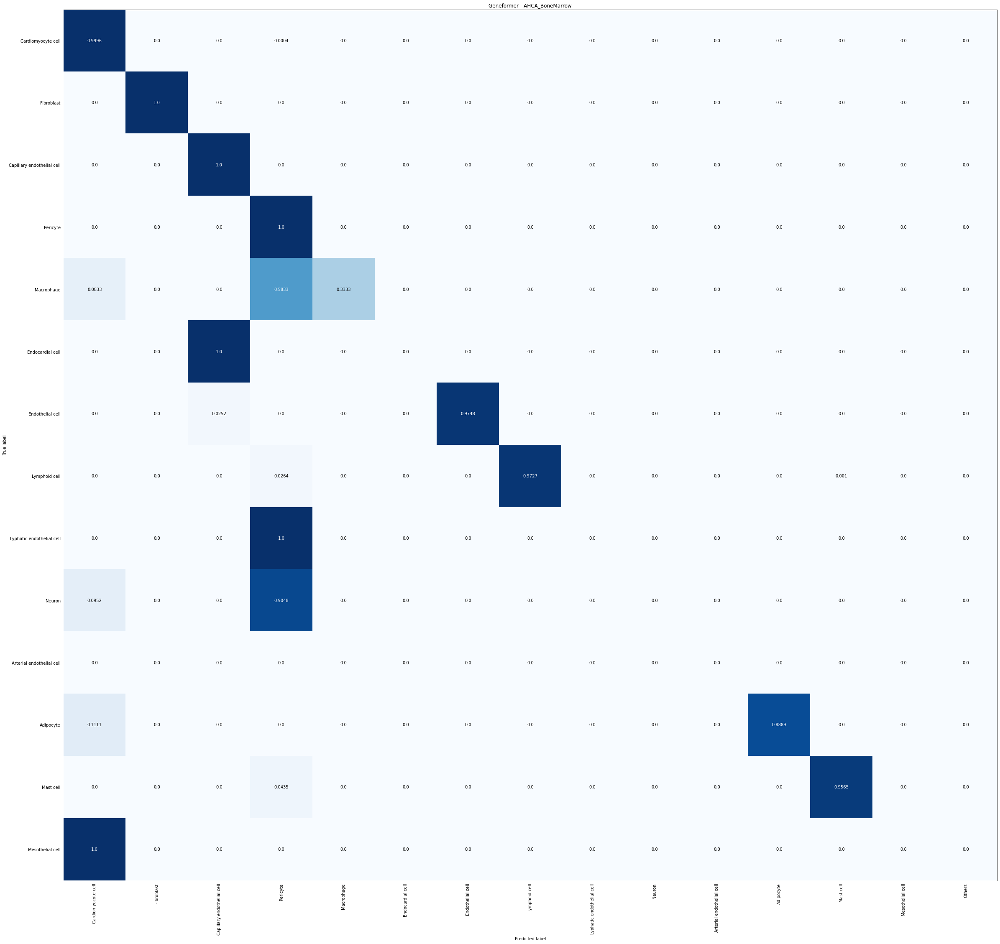

In [103]:
total_labels = list(Counter(targets_ + pred_correct2).keys())

sorted_keys = sorted(Counter(targets_).keys(), key=lambda x: Counter(targets_)[x], reverse=True)
true_labels = sorted_keys.copy()

labels = sorted_keys
labels.extend(set(total_labels) - set(true_labels))

cm = confusion_matrix(targets_, pred_correct, labels=labels)
plot_confusion_matrix(cm, true_labels, labels, "Geneformer - AHCA_BoneMarrow",size =40, saving="anno_figures/BoneMarrow_Geneformer_CM.pdf")

## scGPT finetune on Multiorgan

In [50]:
df_result = pd.read_csv("Multi_result/BoneMarrow_results/AHCA/prediction_result.csv",index_col = 0)

df_result.labels[df_result.labels=="NK T cell"] = "NK cell"
df_result.labels[df_result.labels=="Plasma cell"] = "Plasma B cell"
df_result.labels[df_result.labels=="Erythrocyte"] = "Erythroblast"

preds_ = list(df_result.predictions)
targets_ = list(df_result.labels)

In [51]:
target_cell_types = set(targets_)
pred_correct = []
for pred, target in zip(tqdm(preds_), targets_):
    if pred in uhaf_trace.uhaf.index.tolist() and is_ancester(pred,target, uhaf_trace):
        pred_correct.append(target)
    #elif not pred in target_cell_types:
    #    pred_correct.append("Others")
    else:
        pred_correct.append(pred)

100%|██████████| 3230/3230 [00:00<00:00, 8443.32it/s]


In [52]:
pred_correct2 = pd.Series(pred_correct)
pred_correct2[- pred_correct2.isin(np.unique(targets_))] = "Others"
pred_correct2 = list(pred_correct2)

In [53]:
accuracy = accuracy_score(targets_, pred_correct2)
precision = precision_score(targets_, pred_correct2, average="weighted")
precision_macro = precision_score(targets_, pred_correct2, average="macro")
recall = recall_score(targets_, pred_correct2, average="weighted")
weighted_f1 = f1_score(targets_, pred_correct2, average="weighted")
macro_f1 = f1_score(targets_, pred_correct2, average="macro")

results = {
        "test/accuracy": accuracy,
        "test/precision": precision,
        "test/precision_macro": precision_macro,
        "test/recall": recall,
        "test/weighted_f1": weighted_f1,
        "test/macro_f1": macro_f1,
    }
print(results)

{'test/accuracy': 0.7922600619195046, 'test/precision': 0.8779261275939475, 'test/precision_macro': 0.7593714384571911, 'test/recall': 0.7922600619195046, 'test/weighted_f1': 0.8297697697887432, 'test/macro_f1': 0.6940357741285912}


/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


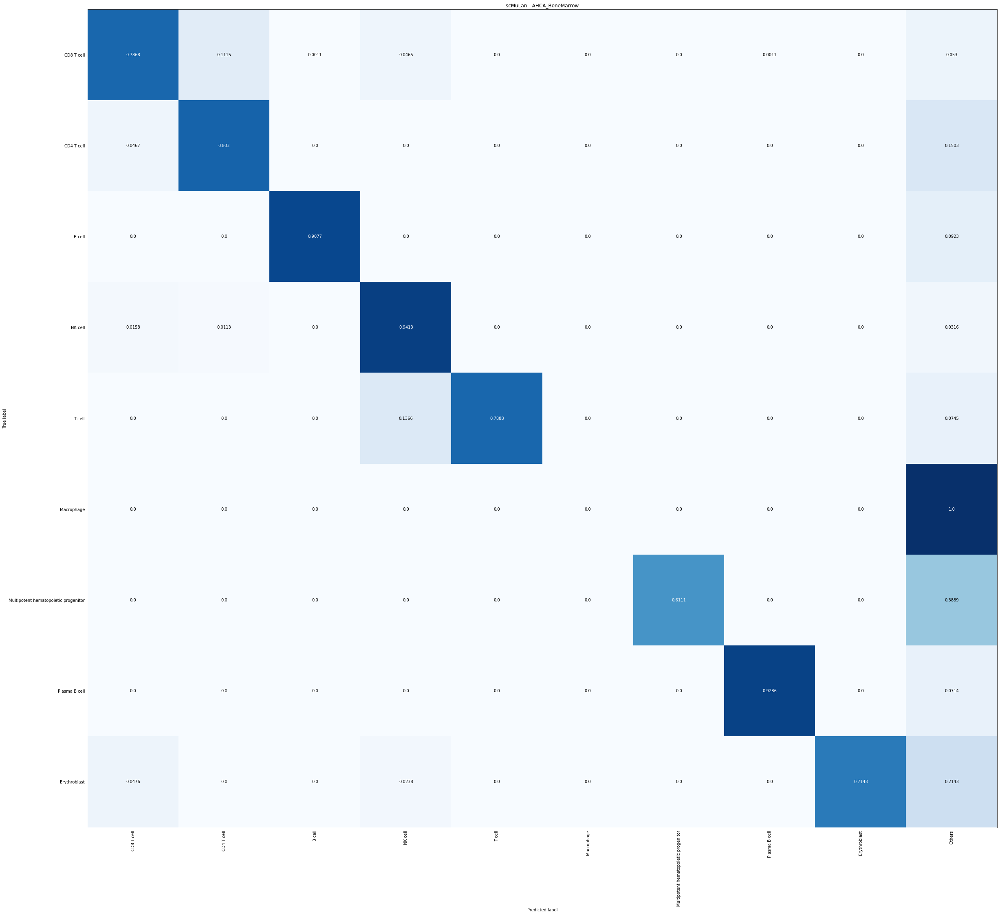

In [54]:
total_labels = list(Counter(targets_ + pred_correct2).keys())

sorted_keys = sorted(Counter(targets_).keys(), key=lambda x: Counter(targets_)[x], reverse=True)
true_labels = sorted_keys.copy()

labels = sorted_keys
labels.extend(set(total_labels) - set(true_labels))

cm = confusion_matrix(targets_, pred_correct2, labels=labels)
plot_confusion_matrix(cm, true_labels, labels, "scMuLan - AHCA_BoneMarrow",size =40, saving="anno_figures/BoneMarrow_scGPT_CM.pdf")

## scMuLan

In [55]:
df_result = pd.read_csv("/nfs/public/cell_gpt_data/Test_data/Heart/bm.csv",index_col = 0)

df_result.cell_type[df_result.cell_type=="NK T cell"] = "NK cell"
df_result.cell_type[df_result.cell_type=="Plasma cell"] = "Plasma B cell"
df_result.cell_type[df_result.cell_type=="Erythrocyte"] = "Erythroblast"

preds_ = list(df_result.preds_ori)
targets_ = list(df_result.cell_type)

/tmp/ipykernel_28905/388525475.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_result.cell_type[df_result.cell_type=="NK T cell"] = "NK cell"
/tmp/ipykernel_28905/388525475.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_result.cell_type[df_result.cell_type=="Plasma cell"] = "Plasma B cell"
/tmp/ipykernel_28905/388525475.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_result.cell_type[df_result.cell_type=="Erythroc

In [56]:
target_cell_types = set(targets_)
pred_correct = []
for pred, target in zip(tqdm(preds_), targets_):
    if pred in uhaf_trace.uhaf.index.tolist() and is_ancester(pred,target, uhaf_trace):
        pred_correct.append(target)
    #elif not pred in target_cell_types:
    #    pred_correct.append("Others")
    else:
        pred_correct.append(pred)

100%|██████████| 3230/3230 [00:00<00:00, 5621.15it/s]


In [57]:
pred_correct2 = pd.Series(pred_correct)
pred_correct2[- pred_correct2.isin(np.unique(targets_))] = "Others"
pred_correct2 = list(pred_correct2)

In [58]:
accuracy = accuracy_score(targets_, pred_correct2)
precision = precision_score(targets_, pred_correct2, average="weighted")
precision_macro = precision_score(targets_, pred_correct2, average="macro")
recall = recall_score(targets_, pred_correct2, average="weighted")
weighted_f1 = f1_score(targets_, pred_correct2, average="weighted")
macro_f1 = f1_score(targets_, pred_correct2, average="macro")

results = {
        "test/accuracy": accuracy,
        "test/precision": precision,
        "test/precision_macro": precision_macro,
        "test/recall": recall,
        "test/weighted_f1": weighted_f1,
        "test/macro_f1": macro_f1,
    }
print(results)

{'test/accuracy': 0.91671826625387, 'test/precision': 0.9612332104642647, 'test/precision_macro': 0.6069187728908394, 'test/recall': 0.91671826625387, 'test/weighted_f1': 0.9367268943483502, 'test/macro_f1': 0.5837803242980395}


/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/data1/chenyx/anaconda3/envs/sc_R4_Py/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


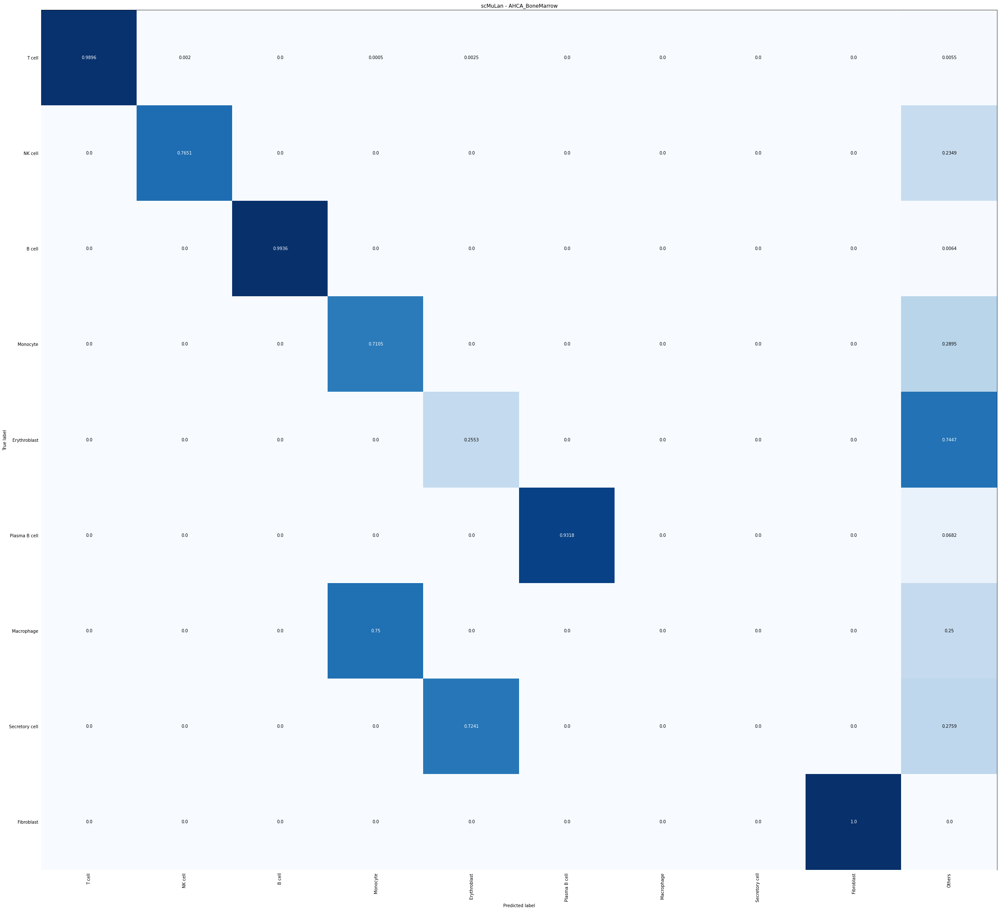

In [59]:
total_labels = list(Counter(targets_ + pred_correct2).keys())

sorted_keys = sorted(Counter(targets_).keys(), key=lambda x: Counter(targets_)[x], reverse=True)
true_labels = sorted_keys.copy()

labels = sorted_keys
labels.extend(set(total_labels) - set(true_labels))

cm = confusion_matrix(targets_, pred_correct2, labels=labels)
plot_confusion_matrix(cm, true_labels, labels, "scMuLan - AHCA_BoneMarrow",size =40, saving="anno_figures/BoneMarrow_scMulan_CM.pdf")

# Visualize UMAP

## Heart

In [ ]:
adata_test = sc.read_h5ad("/nfs/public/cell_gpt_data/Test_data/Heart/Simonson.h5ad")
adata_test = adata_test[adata_test.obs.cell_type != "Unclassified"]

sc.pp.pca(adata_test)
sc.pp.neighbors(adata_test,n_pcs=10)

In [ ]:
sc.tl.umap(adata_test)

In [ ]:
adata_test.obs.cell_type = adata_test.obs.cell_type.astype(str)
adata_test.obs.cell_type[adata_test.obs.cell_type=="Lyphatic endothelial cell"] = "Lymphatic endothelial cell"

/data1/chenyx/anaconda3/envs/Python3.7/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [ ]:
uhaf_trace = uhaf_organ_trace(os.path.join("../", 'uHAF/Heart_pair_ver.csv'))
preds_ = list(pd.read_csv("/nfs/public/cell_gpt_data/Test_data/Heart/simons.csv",index_col=0).loc[adata_test.obs.index, "preds_ori"])
targets_ = list(adata_test.obs.cell_type)
target_cell_types = set(targets_)
pred_correct = []
for pred, target in zip(tqdm(preds_), targets_):
    if pred in uhaf_trace.uhaf.index.tolist() and is_ancester(pred,target, uhaf_trace):
        pred_correct.append(target)
    #elif not pred in target_cell_types:
    #    pred_correct.append("Others")
    else:
        pred_correct.append(pred)
pred_correct2 = pd.Series(pred_correct)
pred_correct2[- pred_correct2.isin(np.unique(targets_))] = "Others"
pred_correct2 = list(pred_correct2)
adata_test.obs['prediction'] = pred_correct2

100%|██████████| 58777/58777 [00:04<00:00, 13106.23it/s]


In [ ]:
adata_test.uns['prediction_colors'] = ['#1f77b4',
 '#279e68',
 '#d62728',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#ff9896',
 '#aaaaaa',
 '#c5b0d5']

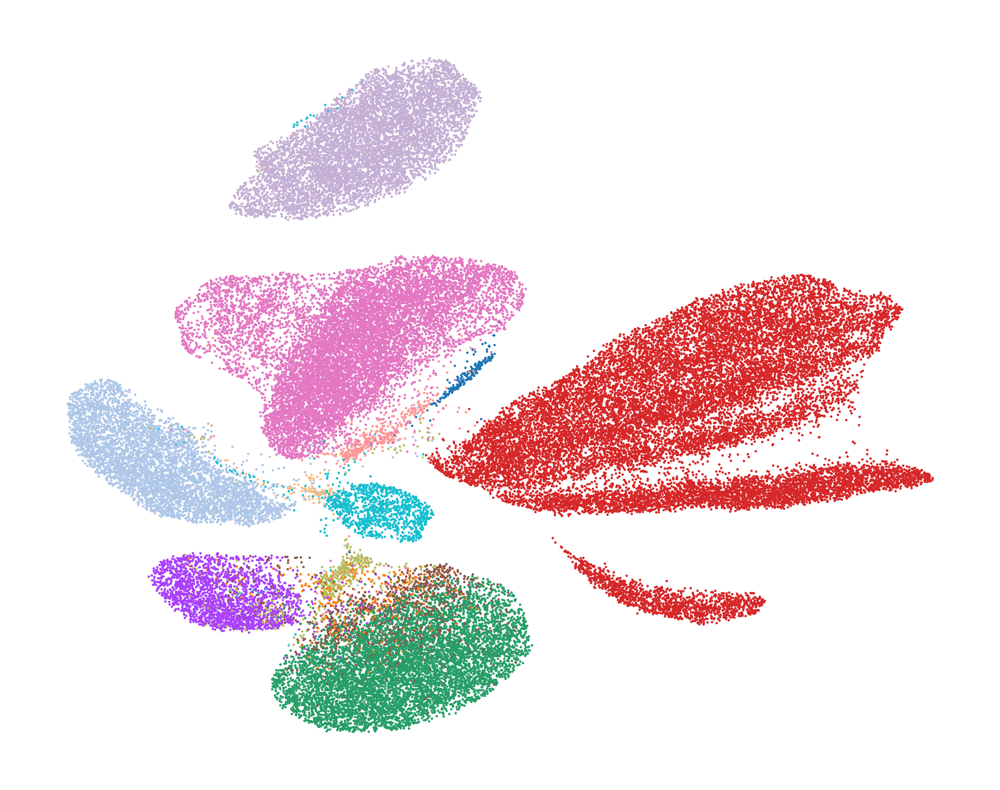

In [ ]:
rcParams['figure.figsize']=(5,4)
sc.pl.umap(adata_test, color="cell_type",legend_loc="",legend_fontsize=8,title="", frameon=False, save="Simonson2023_labels.png")

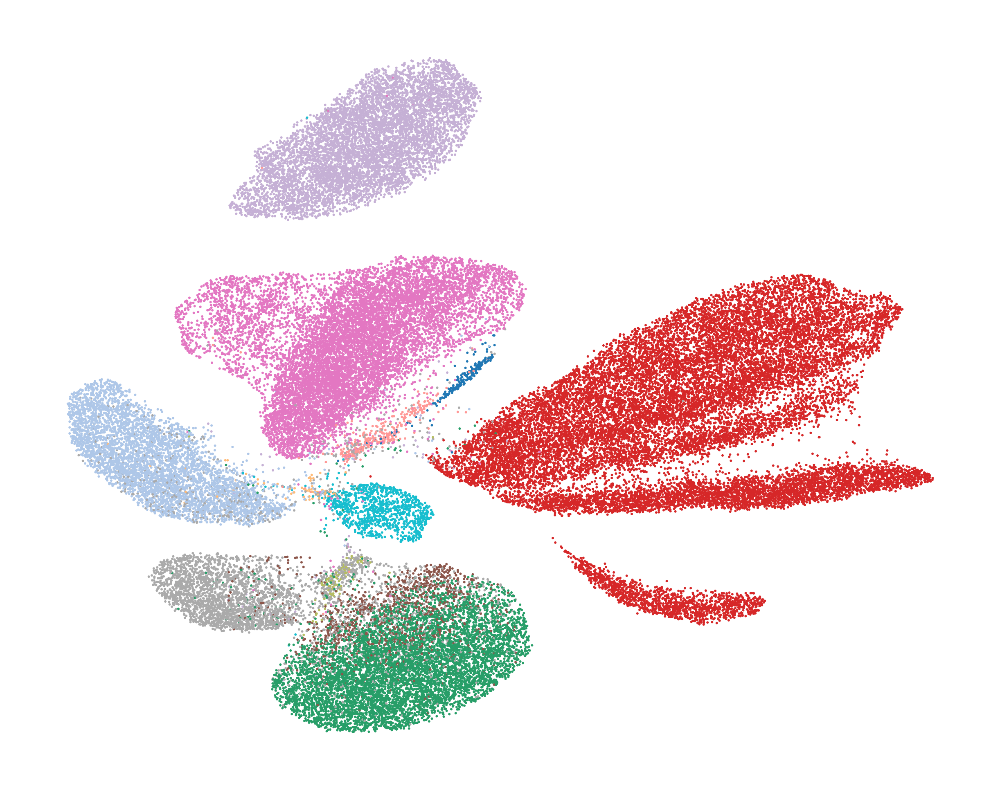

In [ ]:
rcParams['figure.figsize']=(5,4)
sc.pl.umap(adata_test, color="prediction",legend_loc="None",legend_fontsize=8,title="", frameon=False, save="Simonson2023_preds.png")

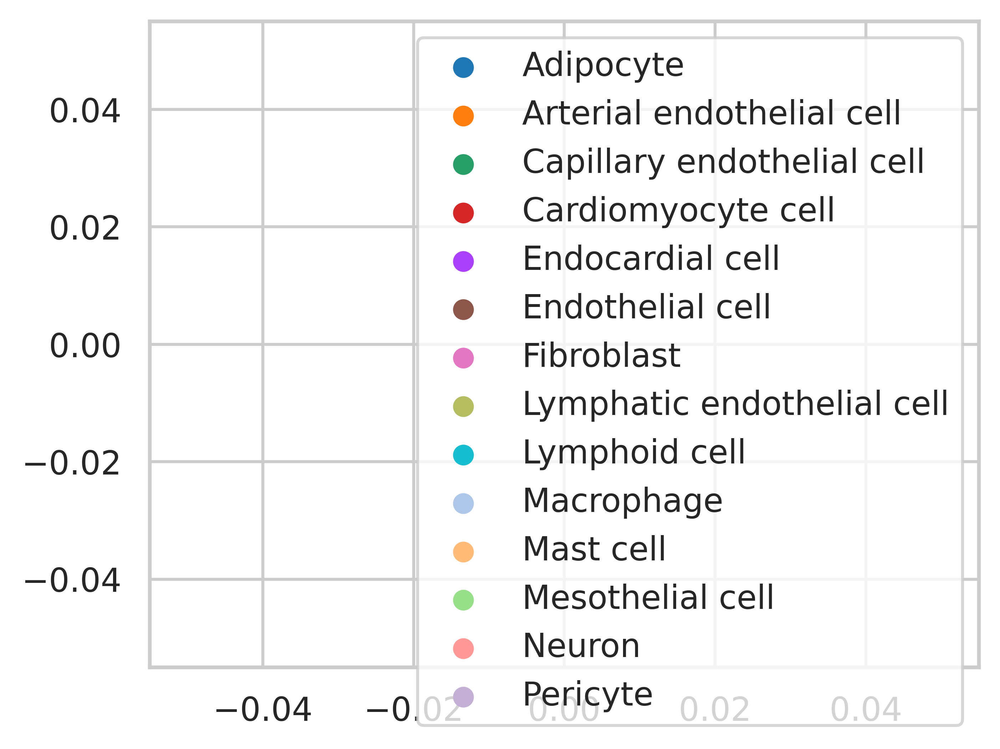

In [ ]:
plt.scatter([], [])

colors = adata_test.uns['cell_type_colors']
labels = adata_test.obs.cell_type.cat.categories

# 根据你的颜色和标签创建图例
for color, label in zip(colors, labels):
    plt.scatter([], [], c=color, label=label)

plt.legend()
plt.savefig("figures/Simonson_labels_Legend.pdf")  # 导出为PDF
plt.show()

## Liver

In [ ]:
from matplotlib import rcParams
rcParams['figure.figsize']=(10,8)
plt.rcParams.update({'font.size': 14})
rcParams['figure.dpi']=600

In [ ]:
adata_test = sc.read_h5ad("/nfs/public/cell_gpt_data/Test_data/Liver/Liver_test.h5ad")
adata_test.obs.cell_type = adata_test.obs.cell_type.astype(str)
adata_test.obs.cell_type[adata_test.obs.cell_type=="Neutrophilic granulocyte"] = "Granulocyte"

/data1/chenyx/anaconda3/envs/Python3.7/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [ ]:
adata_test.obs.cell_type[adata_test.obs.cell_type=='Conventional DC1'] = 'Conventional dendritic cell 1'
adata_test.obs.cell_type[adata_test.obs.cell_type=='Conventional DC2'] = 'Conventional dendritic cell 2'

/data1/chenyx/anaconda3/envs/Python3.7/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
/data1/chenyx/anaconda3/envs/Python3.7/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [ ]:
sc.pp.pca(adata_test)
#sc.pl.pca_variance_ratio(adata_test)
sc.pp.neighbors(adata_test,n_pcs=10)

sc.tl.umap(adata_test)

In [ ]:
uhaf_trace = uhaf_organ_trace(os.path.join("../", 'uHAF/Liver_pair_ver.csv'))
preds_ = list(pd.read_csv("/nfs/public/cell_gpt_data/Test_data/Heart/liver_test_1.csv",index_col=0).loc[adata_test.obs.index, "preds_ori"])
targets_ = list(adata_test.obs.cell_type)
target_cell_types = set(targets_)
pred_correct = []
for pred, target in zip(tqdm(preds_), targets_):
    if pred in uhaf_trace.uhaf.index.tolist() and is_ancester(pred,target, uhaf_trace):
        pred_correct.append(target)
    #elif not pred in target_cell_types:
    #    pred_correct.append("Others")
    else:
        pred_correct.append(pred)
pred_correct2 = pd.Series(pred_correct)
pred_correct2[- pred_correct2.isin(np.unique(targets_))] = "Others"
pred_correct2 = list(pred_correct2)
adata_test.obs['prediction'] = pred_correct2

100%|██████████| 137181/137181 [00:11<00:00, 11531.07it/s]


In [ ]:
adata_test.uns['cell_type_colors']

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2']

In [ ]:
adata_test.uns['prediction_colors'] = ['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#aaaaaa',
 '#c49c94',
 '#f7b6d2']

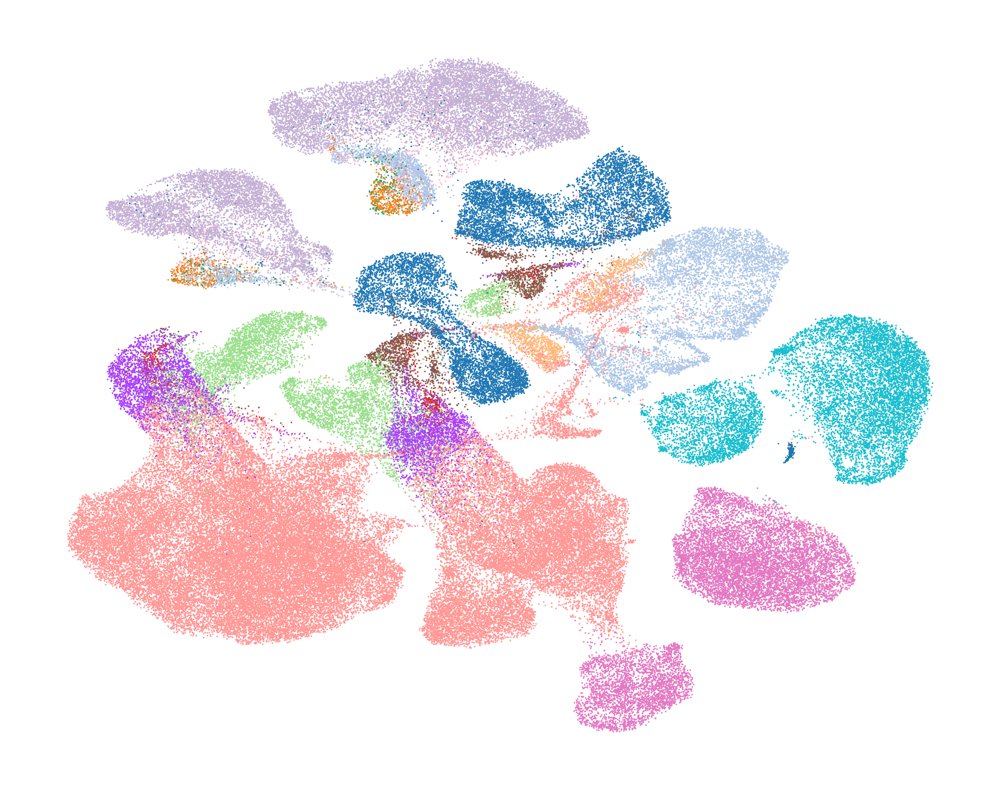

In [ ]:
rcParams['figure.figsize']=(5,4)
sc.pl.umap(adata_test, color="cell_type",legend_loc="None",legend_fontsize=8,title="", frameon=False, save="Suo2022_labels.png")

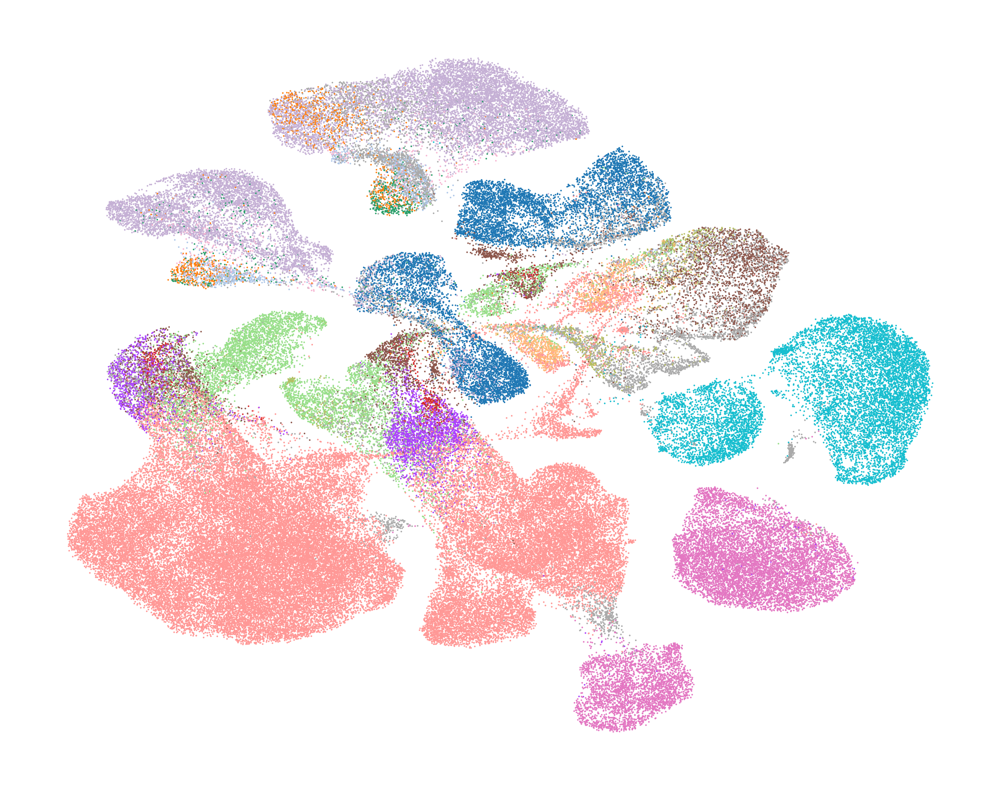

In [ ]:
rcParams['figure.figsize']=(5,4)
sc.pl.umap(adata_test, color="prediction",legend_loc="None",legend_fontsize=8,title="", frameon=False, save="Suo2022_preds.png")

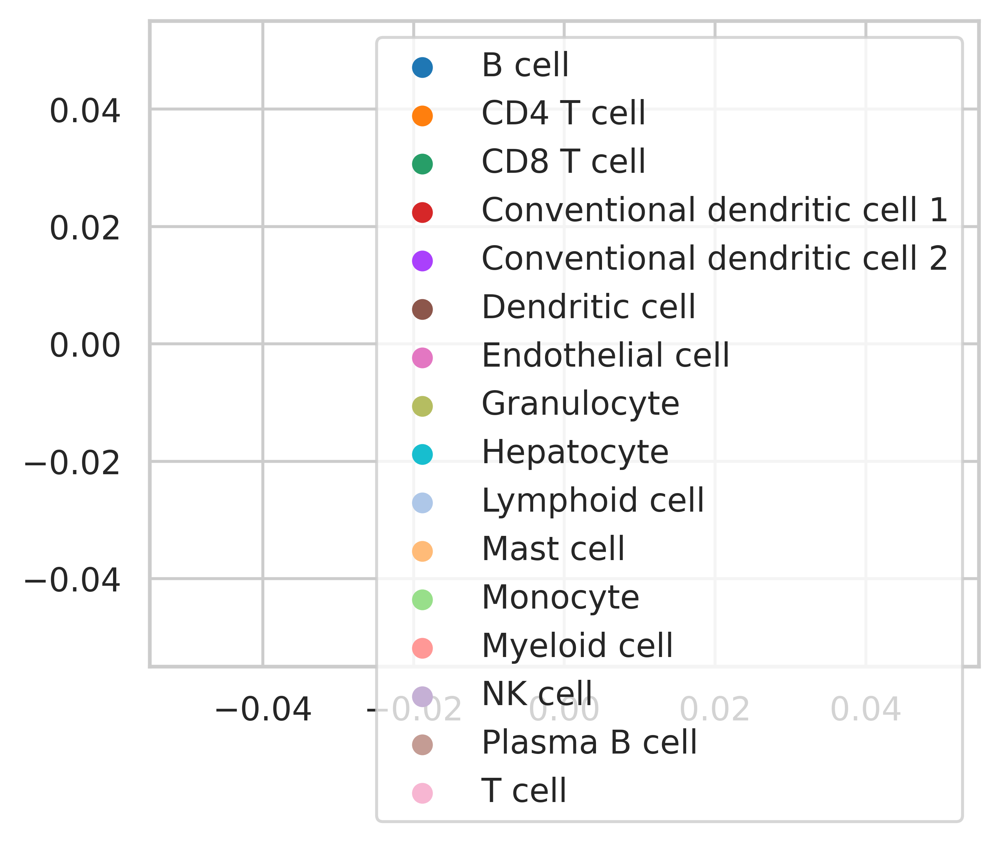

In [ ]:
plt.scatter([], [])

colors = adata_test.uns['cell_type_colors']
labels = adata_test.obs.cell_type.cat.categories

# 根据你的颜色和标签创建图例
for color, label in zip(colors, labels):
    plt.scatter([], [], c=color, label=label)

plt.legend()
plt.savefig("figures/Suo2022_labels_Legend.pdf")  # 导出为PDF
plt.show()

## BoneMarrow

In [ ]:
adata_test = sc.read_h5ad("/nfs/public/cell_gpt_data/dataHub/datasets/datasets/ECA_GO/model_hub/bone_marrow_AHCA_uniformed.h5ad")

In [ ]:
sc.pp.pca(adata_test)
#sc.pl.pca_variance_ratio(adata_test)
sc.pp.neighbors(adata_test,n_pcs=15)

sc.tl.umap(adata_test)

In [ ]:
adata_test.obs.cell_type = adata_test.obs.cell_type.astype(str)
adata_test.obs.cell_type[adata_test.obs.cell_type=="NK T cell"] = "NK cell"
adata_test.obs.cell_type[adata_test.obs.cell_type=="Plasma cell"] = "Plasma B cell"
adata_test.obs.cell_type[adata_test.obs.cell_type=="Erythrocyte"] = "Erythroblast"

/data1/chenyx/anaconda3/envs/Python3.7/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/data1/chenyx/anaconda3/envs/Python3.7/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/data1/chenyx/anaconda3/envs/Python3.7/lib/python3.7/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/us

In [ ]:
uhaf_trace = uhaf_organ_trace('../uHAF/Bone marrow_pair_ver.csv')
preds_ = list(pd.read_csv("/nfs/public/cell_gpt_data/Test_data/Heart/bm.csv",index_col=0).loc[adata_test.obs.index, "preds_ori"])
targets_ = list(adata_test.obs.cell_type)
target_cell_types = set(targets_)
pred_correct = []
for pred, target in zip(tqdm(preds_), targets_):
    if pred in uhaf_trace.uhaf.index.tolist() and is_ancester(pred,target, uhaf_trace):
        pred_correct.append(target)
    #elif not pred in target_cell_types:
    #    pred_correct.append("Others")
    else:
        pred_correct.append(pred)
pred_correct2 = pd.Series(pred_correct)
pred_correct2[- pred_correct2.isin(np.unique(targets_))] = "Others"
pred_correct2 = list(pred_correct2)
adata_test.obs['prediction'] = pred_correct2

100%|██████████| 3230/3230 [00:00<00:00, 4838.98it/s]


In [ ]:
adata_test.uns['prediction_colors'] = ['#4c72b0',
 '#dd8452',
 '#55a868',
 '#8172b3',
 '#937860',
 '#aaaaaa',
 '#da8bc3',
 '#ccb974']

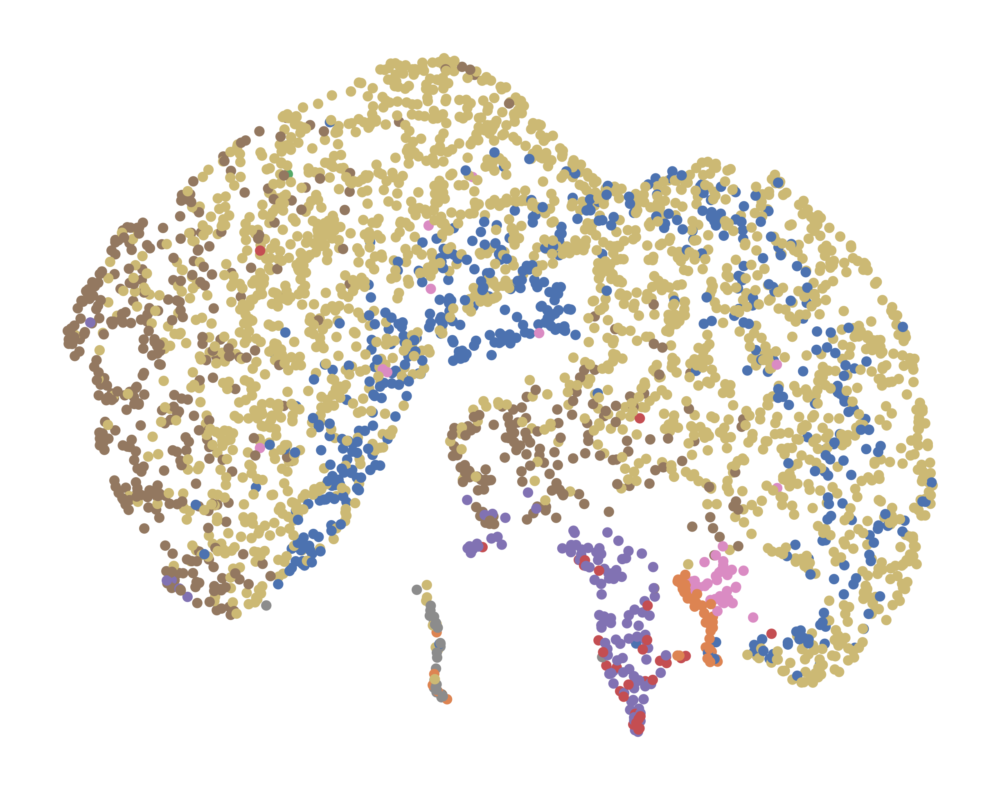

In [ ]:
rcParams['figure.figsize']=(5,4)
sc.pl.umap(adata_test, color="cell_type",legend_loc="None",legend_fontsize=8,title="", frameon=False, save="AHCA_labels.png")

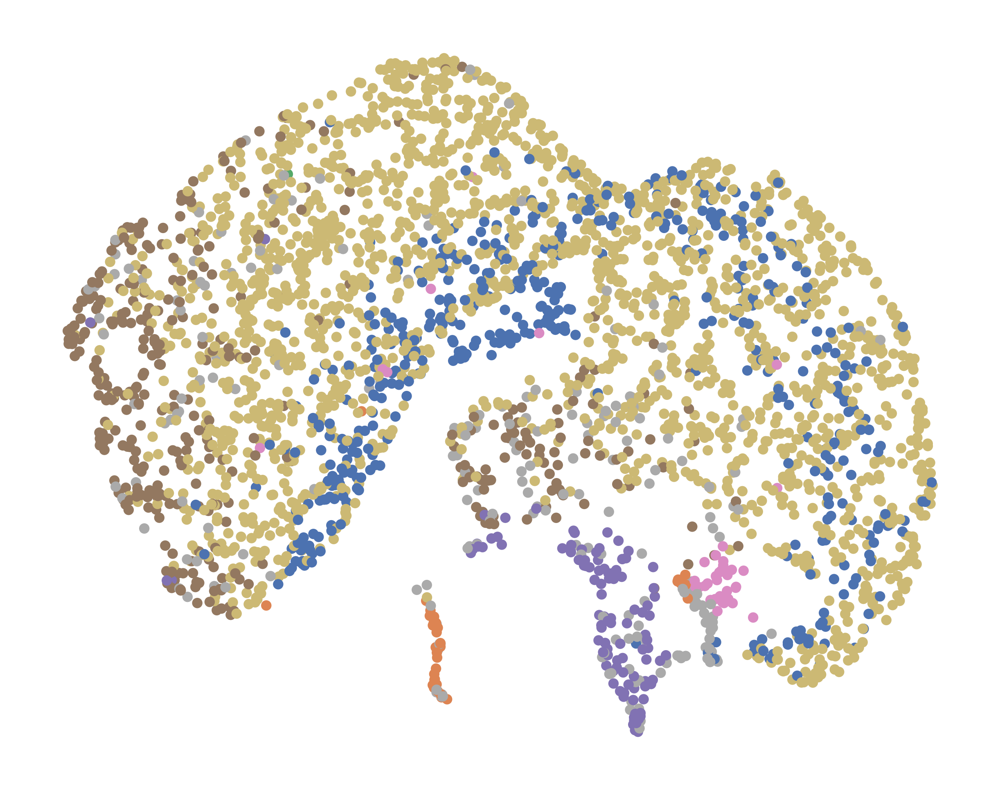

In [ ]:
rcParams['figure.figsize']=(5,4)
sc.pl.umap(adata_test, color="prediction",legend_loc="None",legend_fontsize=8,title="", frameon=False, save="AHCA_preds.png")

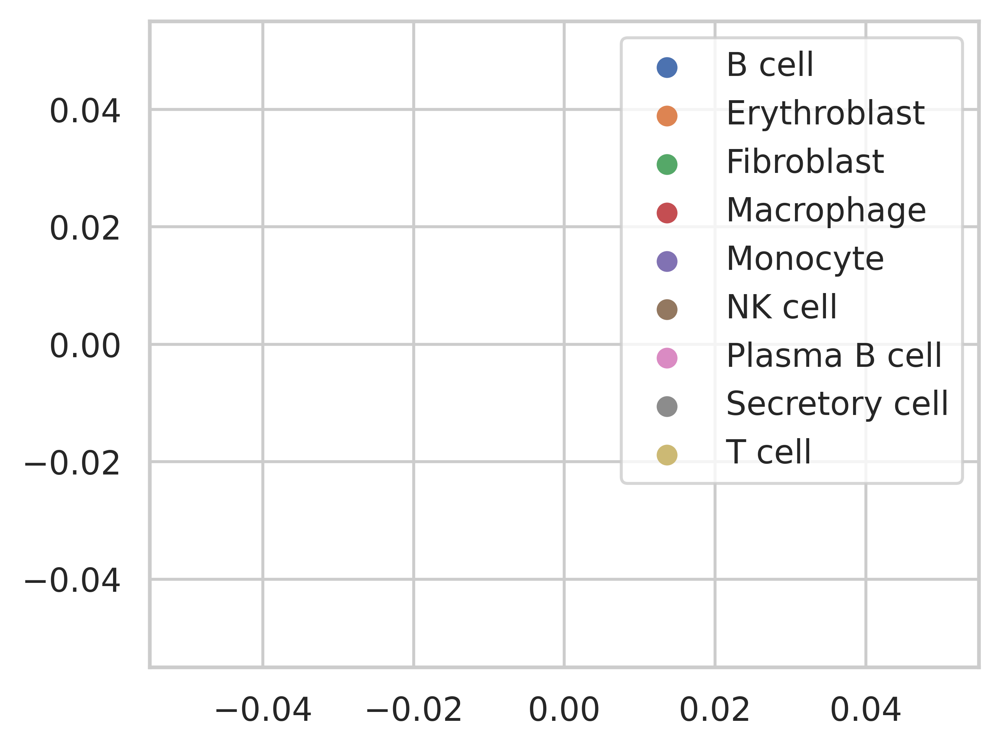

In [ ]:
plt.scatter([], [])

colors = adata_test.uns['cell_type_colors']
labels = adata_test.obs.cell_type.cat.categories

# 根据你的颜色和标签创建图例
for color, label in zip(colors, labels):
    plt.scatter([], [], c=color, label=label)

plt.legend()
plt.savefig("figures/AHCA_labels_Legend.pdf")  # 导出为PDF
plt.show()

# Barplot of the metrics

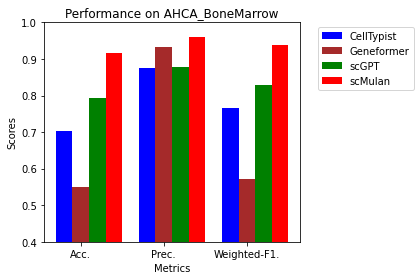

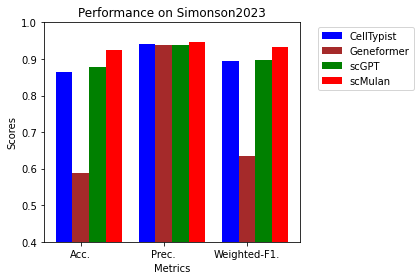

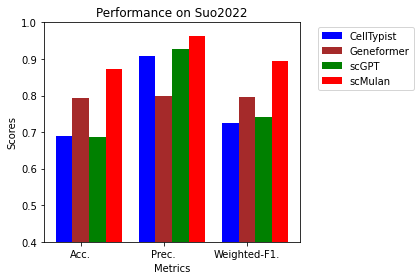

In [111]:
# Data extracted from the image
datasets = ['AHCA_BoneMarrow', 'Simonson2023', 'Suo2022']
methods = ['CellTypist', 'Geneformer', 'scGPT', 'scMulan']
metrics = ['Acc.', 'Prec.', 'Weighted-F1.']

colors = ['blue', 'brown', 'green', 'red']

# Scores for each method on each dataset
scores = {
    'AHCA_BoneMarrow': [
    [0.702, 0.876, 0.766], # celltypist
    [0.551, 0.934, 0.573], # Geneformer
    [0.792, 0.878, 0.830], # scGPT
    [0.917, 0.961, 0.937]], # scMulan
    'Simonson2023': [
    [0.865, 0.942, 0.895], # celltypist
    [0.588, 0.939, 0.635], # Geneformer
    [0.877, 0.938, 0.898], # scGPT
    [0.925, 0.947, 0.933]], # scMulan
    'Suo2022': [
    [0.690, 0.908, 0.725], # celltypist
    [0.793, 0.798, 0.795], # Geneformer
    [0.686, 0.928, 0.740], # scGPT
    [0.873, 0.963, 0.894]], # scMulan
}


for dataset, dataset_scores in scores.items():
    x = np.arange(len(metrics))  # Metrics positions
    width = 0.2  # Width of each bar

    fig, ax = plt.subplots()
    for i, method_scores in enumerate(dataset_scores):
        ax.bar(x + i * width, method_scores, width, label=methods[i], color=colors[i])

    # Add labels, title, and legend
    ax.set_xlabel('Metrics')
    ax.set_ylabel('Scores')
    ax.set_title(f'Performance on {dataset}')
    ax.set_xticks(x + width)
    ax.set_xticklabels(metrics)
    ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    ax.set_ylim(0.4, 1)
    plt.tight_layout()
    plt.savefig(f"anno_figures/{dataset}_metrics.pdf")
    plt.show()

# Visualization Fine-tuning results

In [ ]:
def plot_confusion_matrix(confm, true_labels, all_labels, title, size=20, with_text=True, saving_path = None):
    """
    Plot a confusion matrix.

    Parameters:
    - confm: Original confusion matrix
    - true_labels: List of true labels
    - all_labels: List of all labels in the order they appear in confm
    - title: Title of the plot
    - size: Size of the plot
    - with_text: Whether to include text in the cells
    """
    plt.figure(figsize=(size, size))

    # Extract relevant rows based on true labels
    confm_selected = cm[[labels.index(lab) for lab in true_labels]]

    # Normalize
    confm_selected = confm_selected.astype('float') / (confm_selected.sum(axis=1)[:, np.newaxis] + 1e-9)
    confm_selected = np.around(confm_selected, 2)

    ax = plt.subplot(1, 1, 1)
    plt.imshow(confm_selected, interpolation='nearest', cmap='Blues')

    if with_text:
        for i in range(len(confm_selected)):
            for j in range(len(confm_selected[0])):
                color = 'w' if confm_selected[i, j] > 0.5 else 'black'
                plt.text(j, i, confm_selected[i, j], ha="center", va="center", color=color)

    plt.title(title)
    plt.xticks(np.arange(len(all_labels)), all_labels, rotation=90)
    plt.yticks(np.arange(len(true_labels)), true_labels, rotation=0)
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    #plt.xticks(rotation=45)
    plt.tick_params(bottom=False, top=False, left=False, right=False)
    ax.spines['left'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    if saving_path:
        plt.savefig(saving_path, bbox_inches='tight')
    plt.show()

## scatter plots

In [ ]:
scGPT_metrics = {'accuracy': 0.8626058453974323,  'f1_score_macro': 0.699505261114083,  'precision': 0.7050994927089965}
Geneformer_metrics = {'accuracy': 0.8498588728034234,  'f1_score_macro': 0.6183933101891553,  'precision': 0.6210051761253927}
celltypist_metrics = {'accuracy': 0.789720868409393,  'f1_score_macro': 0.6519895180615649,  'precision': 0.769980190983135}

evaluate_metrics = {#"0":
#(('accuracy', 0.22707821178184467), ('f1_score_macro', 0.255535019324094), ('precision', 0.30915942210091457)),
"20":
(('accuracy', 0.8281890193936083), ('f1_score_macro', 0.6641059562654471), ('precision', 0.7066833519287519)),
"40":
(('accuracy', 0.8586907038149868), ('f1_score_macro', 0.7072783409456868), ('precision', 0.7444421763784813)),
"60":
(('accuracy', 0.8696166803241373), ('f1_score_macro', 0.73573637059813190), ('precision', 0.7560568871211713)),
"80":
(('accuracy', 0.869980879541109), ('f1_score_macro', 0.758230233594697), ('precision', 0.774826001845125)),
"100":
(('accuracy', 0.875717017208413), ('f1_score_macro', 0.7914060555600507), ('precision', 0.8316165833488726))
}

keys = list(evaluate_metrics.keys())
accuracies = [evaluate_metrics[key][0][1] for key in keys]
f1_scores = [evaluate_metrics[key][1][1] for key in keys]
precisions = [evaluate_metrics[key][2][1] for key in keys]

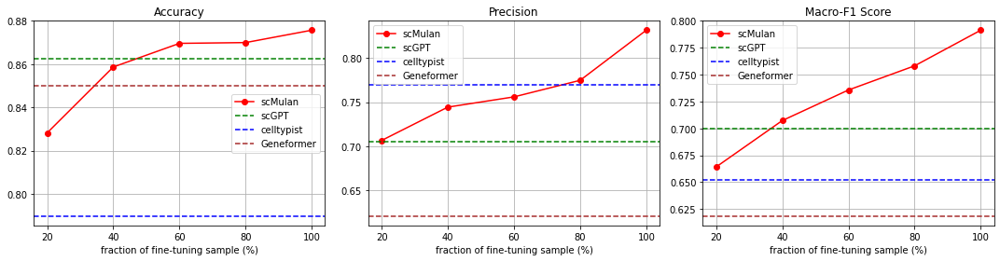

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(15, 4))

line1, = axes[0].plot(keys, accuracies, marker='o', linestyle='-', color='r', label='scMulan')
line2 = axes[0].axhline(y=scGPT_metrics['accuracy'], color='g', linestyle='--', label='scGPT')
line3 = axes[0].axhline(y=celltypist_metrics['accuracy'], color='b', linestyle='--', label='celltypist')
line4 = axes[0].axhline(y=Geneformer_metrics['accuracy'], color='brown', linestyle='--', label='Geneformer')
axes[0].set_title('Accuracy')
axes[0].set_xlabel('fraction of fine-tuning sample (%)')
axes[0].set_ylabel('')
axes[0].legend(loc='best')
axes[0].grid(True)

line5, = axes[1].plot(keys, precisions, marker='o', linestyle='-', color='r', label='scMulan')
line6 = axes[1].axhline(y=scGPT_metrics['precision'], color='g', linestyle='--', label='scGPT')
line7 = axes[1].axhline(y=celltypist_metrics['precision'], color='b', linestyle='--', label='celltypist')
line8 = axes[1].axhline(y=Geneformer_metrics['precision'], color='brown', linestyle='--', label='Geneformer')
axes[1].set_title('Precision')
axes[1].set_xlabel('fraction of fine-tuning sample (%)')
axes[1].set_ylabel('')
axes[1].legend(loc='best')
axes[1].grid(True)

line9, = axes[2].plot(keys, f1_scores, marker='o', linestyle='-', color='r', label='scMulan')
line10 = axes[2].axhline(y=scGPT_metrics['f1_score_macro'], color='g', linestyle='--', label='scGPT')
line11 = axes[2].axhline(y=celltypist_metrics['f1_score_macro'], color='b', linestyle='--', label='celltypist')
line12 = axes[2].axhline(y=Geneformer_metrics['f1_score_macro'], color='brown', linestyle='--', label='Geneformer')
axes[2].set_title('Macro-F1 Score')
axes[2].set_xlabel('fraction of fine-tuning sample (%)')
axes[2].set_ylabel('')
axes[2].legend(loc='best')
axes[2].grid(True)

plt.tight_layout()
plt.savefig("figures/Finetine_metrics_20240102.pdf", bbox_inches='tight')
plt.show()

## confusion Matrix

In [ ]:
import pickle
with open("../Intestine_result/scMulan.pkl","rb") as file:
    scMulan_dict = pickle.load(file)

In [ ]:
scMulan_dict.keys()

dict_keys(['preds', 'targets'])

In [ ]:
plt.rcParams['font.family'] = 'Arial'

In [ ]:
targets_ = scMulan_dict['targets']
preds_ = scMulan_dict['preds']

total_labels = list(Counter(targets_ + preds_).keys())

sorted_keys = sorted(Counter(targets_).keys(), key=lambda x: Counter(targets_)[x], reverse=True)
true_labels = sorted_keys.copy()

labels = sorted_keys
labels.extend(set(total_labels) - set(true_labels))

cm = confusion_matrix(targets_, preds_, labels=labels)

plot_confusion_matrix(cm, true_labels, labels, "scMulan_Intestine",size =15,saving_path="figures/Finetine_scMulan_ConfusionMatrix.pdf")

In [ ]:
import pickle
with open("../Intestine_result/scMulan_withoutFT.pkl","rb") as file:
    scMulan_dict = pickle.load(file)
    
targets_ = scMulan_dict['targets']
preds_ = scMulan_dict['preds']

accuracy = accuracy_score(targets_, preds_)
precision = precision_score(targets_, preds_, average="macro")
recall = recall_score(targets_, preds_, average="macro")
macro_f1 = f1_score(targets_, preds_, average="macro")

results = {
        "test/accuracy": accuracy,
        "test/precision": precision,
        "test/recall": recall,
        "test/macro_f1": macro_f1,
    }
print(results)

{'test/accuracy': 0.22707821178184467, 'test/precision': 0.30915942210091457, 'test/recall': 0.36587330818685837, 'test/macro_f1': 0.255535019324094}


/data1/chenyx/anaconda3/envs/Python3.7/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
total_labels = list(Counter(targets_ + preds_).keys())

sorted_keys = sorted(Counter(targets_).keys(), key=lambda x: Counter(targets_)[x], reverse=True)
true_labels = sorted_keys.copy()

labels = sorted_keys
labels.extend(set(total_labels) - set(true_labels))

cm = confusion_matrix(targets_, preds_, labels=labels)

plot_confusion_matrix(cm, true_labels, labels, "scMulan_Intestine",size =15,saving_path="figures/Nofinetine_scMulan_ConfusionMatrix.pdf")